In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from scipy.sparse import hstack
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import Normalizer
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix, classification_report
import pickle

#pip install pyspellchecker
#pip install fuzzywuzzy
#pip install python-Levenshtein
#conda install -c conda-forge spacy
#pip install -U pip setuptools wheel
#pip install -U spacy
#!python3 -m spacy download en_core_web_sm

#import sys
#!{sys.executable} -m pip install spacy
#!{sys.executable} -m spacy download en
#!pip list 

# for keeping track of timing
import datetime as dt
import numpy as np

# for building in wait times
import random
import time


from google_play_scraper import app
from google_play_scraper import Sort, reviews
from google_play_scraper import reviews_all
from google_play_scraper import permissions

from spellchecker import SpellChecker
from textblob import TextBlob

import spacy  
from spacy.lang.en import English

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize 
import nltk
from nltk.stem import WordNetLemmatizer
#nltk.download('stopwords')
#nltk.download('punkt')


from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from nltk.stem.snowball import SnowballStemmer
  

import re
import pandas as pd


In [3]:
pip install --upgrade scikit-learn

Requirement already up-to-date: scikit-learn in /Users/hannah/opt/anaconda3/lib/python3.8/site-packages (1.0)
Note: you may need to restart the kernel to use updated packages.


In [24]:

with open('glove_vectors', 'rb') as f:
    model = pickle.load(f)
    glove_words =  set(model.keys())

with open('SVMmodel', 'rb') as f:
    SVMmodel = pickle.load(f)

/Users/hannah/opt/anaconda3/lib/python3.8/site-packages/sklearn/base.py:324: UserWarning: Trying to unpickle estimator SVC from version 0.24.1 when using version 1.0. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/modules/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [4]:
app_id=[
        'com.coolots.chaton'
        ]

app_nm=[
    'ChatON Voice'
    ]

#SHIHAN WE CAN WRITE AN INPUT CODE HERE, LIKE.... INPUT APP ID: __________

In [5]:
## IN THIS CODE WE ARE SCRAPING 2000 REVIEWS OF THE CHOSEN APP

#X is a dataframe that has one column called content

df=pd.DataFrame()
##Loop through apps to get reviews
for app_nm, app_id in zip(app_nm, app_id):
    
    # Get start time
    start = dt.datetime.now()
    fmt= "%m/%d/%y - %T %p"    
    
    # Print starting output for app
    print('---'*20)
    print('---'*20)    
    print(f'***** {app_nm} started at {start.strftime(fmt)}')
    print()
    
    # Empty list for storing reviews
    app_reviews = []
    
    # Number of reviews to scrape per batch
    count = 200
    
    # To keep track of how many batches have been completed
    batch_num = 0
    rvws, token = reviews(
              app_id,           # found in app's url
              lang='en',        # defaults to 'en'
              country='us',     # defaults to 'us'
              sort=Sort.NEWEST, # start with most recent
              count=count       # batch size
          )
    
    # For each review obtained
    for r in rvws:
        r['app_name'] = app_nm # add key for app's name
        r['app_id'] = app_id     # add key for app's id
        # Increase batch count by one        
    app_reviews.extend(rvws)
    
    
    for batch_num in range(1, 10): #3500 reviews from each app
    
        rvws, token = reviews(
              app_id,           # found in app's url
              continuation_token=token # batch size
          )
        # For each review obtained
        for r in rvws:
            r['app_name'] = app_nm # add key for app's name
            r['app_id'] = app_id     # add key for app's id
        # Increase batch count by one
        
        app_reviews.extend(rvws)
        #print(app_reviews)
        batch_num +=1 
        print(f'Batch {batch_num} completed.')

        #Wait 1 to 5 seconds to start next batch
        time.sleep(random.randint(1,2))
        
    df=df.append(app_reviews)
    

------------------------------------------------------------
------------------------------------------------------------
***** ChatON Voice started at 10/15/21 - 00:05:55 AM

Batch 2 completed.
Batch 3 completed.
Batch 4 completed.
Batch 5 completed.
Batch 6 completed.
Batch 7 completed.
Batch 8 completed.
Batch 9 completed.
Batch 10 completed.



## HANNAH NOW WE DO PREPROCESSING stemming lemmatization and stuff



In [5]:
#FUNCTION FOR SPELL CHECKING

counter=0

def spell_check(user_rvw):
    global counter
    
    if type(user_rvw) != str:
        return (" ")
 
    #print(f'Original Comment: {user_rvw} -->')
    spell = SpellChecker()
    
    words = spell.split_words(user_rvw)
    
    words=[spell.correction(word) for word in words]
    
    user_rvw = " ".join(words)
    
    user_rvw = user_rvw.strip()
    
    #print(f'Spell-Checked Comment: {user_rvw}\n')
    
    #textBlb = TextBlob(user_rvw)  # Making textblob
    
    #user_rvw= str(textBlb.correct())   # Correcting the text
    
    counter = counter+1
    if counter%100==0:
        print (f"{counter} rows spell checked \n")
    
    return user_rvw


In [6]:
def decontracted(phrase):
    if type(phrase) != str:
        return(" ")
 
    # specific
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

In [7]:
counter=0


def lemmetizer(user_rvw):
    
    global counter
    
    if type(user_rvw) != str:
        return(" ")
 

    #set(stopwords.words('english'))

    text = user_rvw
    
    #stop_words = set(stopwords.words('english')) 
  
    word_tokens = word_tokenize(text) 
    
    filtered_sentence = [] 
  
    for w in word_tokens: 
        if True:# w not in stop_words: 
            filtered_sentence.append(w) 
    #print(filtered_sentence) 

    lemma_word = []
    wordnet_lemmatizer = WordNetLemmatizer()
    for w in filtered_sentence:
        word1 = wordnet_lemmatizer.lemmatize(w, pos = "n")
        word2 = wordnet_lemmatizer.lemmatize(word1, pos = "v")
        word3 = wordnet_lemmatizer.lemmatize(word2, pos = ("a"))
        lemma_word.append(word3)
    #print(f'{user_rvw} ---> {lemma_word}')
    #print('\n')
    
    user_rvw = " ".join(lemma_word)
    
    user_rvw = user_rvw.strip()
    
    counter = counter+1
    if counter%1000==0:
        print (f"{counter} rows lemmatized \n")
        print(f'{user_rvw} ---> {lemma_word}')
        print('\n')
    
    
    
    return user_rvw
    
    



In [8]:
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
    
counter=0

def stop_word_remover(user_rvw):
    
    global counter
 
    """# Load English tokenizer, tagger, parser, NER and word vectors
    nlp = English()

    text = user_rvw
    #  "nlp" Object is used to create documents with linguistic annotations.
    my_doc = nlp(text)

    # Create list of word tokens
    token_list = []
    for token in my_doc:
        token_list.append(token.text)

    from spacy.lang.en.stop_words import STOP_WORDS

    # Create list of word tokens after removing stopwords
    filtered_sentence =[] 

    for word in token_list:
        lexeme = nlp.vocab[word]
        if lexeme.is_stop == False:
            filtered_sentence.append(word) 
    #print(f"{token_list} \n ---> {filtered_sentence}\n")
    
    user_rvw = " ".join(filtered_sentence)"""
    
    stop_words = stopwords.words('english')
    
    stop_words.remove('not')
    stop_words.remove('no')
    stop_words.remove('until')
    stop_words.remove('over')
    stop_words.remove('against')
    stop_words.remove('above')
    stop_words.remove('below')
    stop_words.remove('while')
    stop_words.append('fuck')
 
    word_tokens = word_tokenize(user_rvw)
 
    filtered_sentence = [w for w in word_tokens if not w.lower() in stop_words]
 
    filtered_sentence = []
 
    for w in word_tokens:
        if w not in stop_words:
            filtered_sentence.append(w)
 
    print(word_tokens)
    print(filtered_sentence)
    print("\n")
    
    user_rvw = " ".join(filtered_sentence)
    
    user_rvw=user_rvw.lower()
    
    counter = counter+1
    if counter%1000==0:
        print (f"{counter} rows stopword removed \n")
        print(f"{user_rvw} \n ---> {filtered_sentence}\n")
        print('\n')
    
    
    
    
    
    return user_rvw
 

## Preparing Data for Visualisation

In [9]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
counter = 0
def sentiment_checking(review):
    global counter
    analyzer = SentimentIntensityAnalyzer()
    vs = analyzer.polarity_scores(review)
    compound_score = vs.get('compound')
    senti = 'neutral'
    if compound_score <= -0.05:
        senti = 'negative'
    elif compound_score >= 0.05:
        senti = 'positive'
        
    counter = counter+1
    if counter%100==0:
        print (f"{counter} rows checked \n")
        
    return senti



In [ ]:
### Check if review contents arabic word ####

import re

def check_eng(content):
    if re.findall("[\u0600-\u06FF]+", content):
        return True
    else:
        return False

In [29]:
df = pd.read_excel('../reviews_group_by_version.xlsx')

In [30]:
### APPLY ALL THE FUNCTIONS TO THE DATAFRAME df IN THE GIVEN ORDER

concated_df.dropna(inplace=True)
counter=0
concated_df['sentiment'] = concated_df['content'].apply(sentiment_checking)

counter=0
df['content_cleaned'] = df['content'].apply(spell_check)

counter=0
df['content_cleaned'] = df['content_cleaned'].apply(decontracted)

counter=0
df['content_cleaned'] = df['content_cleaned'].apply(lemmetizer)

100 rows spell checked 

200 rows spell checked 

300 rows spell checked 

400 rows spell checked 

500 rows spell checked 

600 rows spell checked 

700 rows spell checked 

800 rows spell checked 

900 rows spell checked 

1000 rows spell checked 

1100 rows spell checked 

1200 rows spell checked 

1300 rows spell checked 

1400 rows spell checked 

1500 rows spell checked 

1600 rows spell checked 

1700 rows spell checked 

1800 rows spell checked 

1900 rows spell checked 

2000 rows spell checked 

2100 rows spell checked 

2200 rows spell checked 

2300 rows spell checked 

2400 rows spell checked 

2500 rows spell checked 

2600 rows spell checked 

2700 rows spell checked 

2800 rows spell checked 

2900 rows spell checked 

3000 rows spell checked 

3100 rows spell checked 

3200 rows spell checked 

3300 rows spell checked 

3400 rows spell checked 

3500 rows spell checked 

3600 rows spell checked 

3700 rows spell checked 

3800 rows spell checked 

3900 rows spell check

30900 rows spell checked 

31000 rows spell checked 

31100 rows spell checked 

31200 rows spell checked 

31300 rows spell checked 

31400 rows spell checked 

31500 rows spell checked 

31600 rows spell checked 

31700 rows spell checked 

31800 rows spell checked 

31900 rows spell checked 

32000 rows spell checked 

32100 rows spell checked 

32200 rows spell checked 

32300 rows spell checked 

32400 rows spell checked 

32500 rows spell checked 

32600 rows spell checked 

32700 rows spell checked 

32800 rows spell checked 

32900 rows spell checked 

33000 rows spell checked 

33100 rows spell checked 

33200 rows spell checked 

33300 rows spell checked 

33400 rows spell checked 

33500 rows spell checked 

33600 rows spell checked 

33700 rows spell checked 

33800 rows spell checked 

33900 rows spell checked 

34000 rows spell checked 

34100 rows spell checked 

34200 rows spell checked 

34300 rows spell checked 

34400 rows spell checked 

34500 rows spell checked 

3

27000 rows lemmatized 

Very nice help me out a lot ---> ['Very', 'nice', 'help', 'me', 'out', 'a', 'lot']


28000 rows lemmatized 

Live map for couid restriction doe not render correctly on put pro ---> ['Live', 'map', 'for', 'couid', 'restriction', 'doe', 'not', 'render', 'correctly', 'on', 'put', 'pro']


29000 rows lemmatized 

Excellent ---> ['Excellent']


30000 rows lemmatized 

Useless app Good for nothing Total time waste ---> ['Useless', 'app', 'Good', 'for', 'nothing', 'Total', 'time', 'waste']


31000 rows lemmatized 

Very quickly and good ---> ['Very', 'quickly', 'and', 'good']


32000 rows lemmatized 

What be wrong with your driver You book a cab and opt for Cash payment when the ride end and the driver receive his payment but he doe not update payment status and it be leave pending This be not the first time and not just me a lot of my friend face the same problem a well And moreover if you opt for online payment a lot of your driver receive the call ask about the mod

In [11]:
## WARNING DO NOT USE THIS STATEMENT

#df['content_cleaned'] = df['content_cleaned'].apply(stop_word_remover)

df.drop('content', inplace=True)

#WRITE CODE TO DROP content column

# SHIHAN NOW WE CAN DROP the COLUMN content and JUST KEEP content_cleaned

# "data" is a dataframe that contains content which is preprocessed and converted to content_cleaned 

## This will be our input to the model

whatever the model outputs is the prediction

In [31]:
X_train=df

# average Word2Vec
# compute average word2vec for each review.
avg_w2v_vectors_train = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(X_train['content_cleaned']): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    cnt_words = 0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if word in glove_words:
            vector += model[word]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    avg_w2v_vectors_train.append(vector)

print(len(avg_w2v_vectors_train))
print(len(avg_w2v_vectors_train[0]))

100%|██████████| 35054/35054 [00:00<00:00, 69028.51it/s]

35054
300


In [32]:
avg_w2v_vectors_train = np.array(avg_w2v_vectors_train)
#type(avg_w2v_vectors_cv)

X_Test2 = avg_w2v_vectors_train


In [33]:
print("Final Data Matrix")
print(X_Test2.shape)

Final Data Matrix
(35054, 300)


In [34]:
y_pred=SVMmodel.predict(X_Test2)

In [35]:
predictions=pd.DataFrame(y_pred, columns=['predictions'])
predictions.value_counts()

predictions
0              27155
1              7899 
dtype: int64

In [36]:
concated_df=pd.concat([df,predictions], axis=1)

In [45]:

concated_df.info()

def rename_version_group(old_name):
    return old_name.replace('ver', 'version_group')

concated_df['version_group']=concated_df['version_group'].apply(rename_version_group)

concated_df = concated_df.loc[:, ~concated_df.columns.str.contains('^Unnamed')]
concated_df.to_excel('predictions_result.xlsx')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35054 entries, 0 to 35053
Data columns (total 7 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   content               35053 non-null  object
 1   score                 35054 non-null  int64 
 2   reviewCreatedVersion  35046 non-null  object
 3   app_name              35054 non-null  object
 4   version_group         35054 non-null  object
 5   content_cleaned       35054 non-null  object
 6   predictions           35054 non-null  int64 
dtypes: int64(2), object(5)
memory usage: 1.9+ MB


In [38]:
pd.set_option('display.max_rows', None)  # or 1000
pd.set_option('display.max_colwidth', -1)  # or 19
concated_df['content'][concated_df['predictions']==1]

<ipython-input-38-4c68f7d269cb>:2: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)  # or 19


0        I got catfished and because I didn't call my imposter date back, she must have made some kind of bogus complaint and got me banned from app without any rrason that I was given. I never cursed or got rude on here by any means whatsoever. It was limited regardless.                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        

# AND WE CAN NOW VISUALIZE THE CLASSIFICATION RESULTS

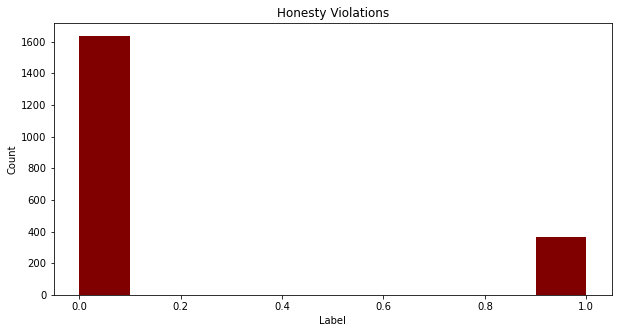

In [20]:
import numpy as np
import matplotlib.pyplot as plt
 
  
# creating the dataset
data = y_pred
  
fig = plt.figure(figsize = (10, 5))
 
# creating the bar plot
plt.hist(data, color ='maroon')
 
plt.xlabel("Label")
plt.ylabel("Count")
plt.title("Honesty Violations")
plt.show()

In [52]:
concated_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 35045 entries, 0 to 35053
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   content               35045 non-null  object
 1   score                 35045 non-null  int64 
 2   reviewCreatedVersion  35045 non-null  object
 3   app_name              35045 non-null  object
 4   version_group         35045 non-null  object
 5   content_cleaned       35045 non-null  object
 6   predictions           35045 non-null  int64 
 7   sentiment             35045 non-null  object
dtypes: int64(2), object(6)
memory usage: 2.4+ MB


## Topic Classification

In [2]:
#importing packages
import numpy as np
import json 
#import glob
import nltk
#Gensim
import gensim
import gensim.corpora as corpora  #To work with textual data
from gensim.utils import simple_preprocess  #For preprocess data
from gensim.models import CoherenceModel

#spacy
import spacy
from nltk.corpus import stopwords

#vis

import pyLDAvis  #To visualize LDA models
#import pyLDAvis.gensim

# nltk.download('stopwords')
# stop_words = stopwords.words('english')
from gensim.parsing.preprocessing import remove_stopwords

In [44]:

concated_df = pd.read_excel('predictions_result.xlsx')
concated_df = concated_df.loc[:, ~concated_df.columns.str.contains('^Unnamed')]
concated_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35045 entries, 0 to 35044
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   content               35045 non-null  object
 1   score                 35045 non-null  int64 
 2   reviewCreatedVersion  35045 non-null  object
 3   app_name              35045 non-null  object
 4   version_group         35045 non-null  object
 5   content_cleaned       35012 non-null  object
 6   predictions           35045 non-null  int64 
 7   sentiment             35045 non-null  object
dtypes: int64(2), object(6)
memory usage: 2.1+ MB


In [46]:
concated_df['non_eng'] = concated_df['content'].apply(check_eng)
concated_df = concated_df[concated_df['non_eng']==False]

concated_df.info()

التحديث الجديد شكله وحش جدا يا ريت ترجعوه زى ما كان لان الوانه الجديدة تتعب العين وده هيخلي كتير مننا يمسحه
جميل
كيفي
كيفي
چرا نمیشه رو یه نرم افزار چند تا اکانت داشت درست مثل تلگرام لطفا تو اپدیت جدید این گزینه رو اضافه کنید بتونیم چند تا اکانت رو یه واتس اپ داشته باشیم
تنها آنی که توی این آن دونی فیلتر نیست خاک بر سر این آپ و مهمتر از همه خاک بر سرت مارک زوکربرگ با این آشغال که دست مردم دادی
چرا رنگ واتس خراب کردین همه چی کمرنگ شده🤢👎👎👎یذره خلاق باشید هنوز ادیت پیام هم نداره اه🤬😤
التحديث الجديد شكله وحش جدا يا ريت ترجعوه زى ما كان لان الوانه الجديدة تتعب العين وده هيخلي كتير مننا يمسحه
یه کاری کنید بدون اینکه زبان گوشی رو عوض کنیم بتونیم توی تنظیمات واتساپ خوده واتسامو انگلیسی کنیم ممنون میشم
التحديث الجديد لونوا مش لطيف لي.
كيفي
عالی البته بعد تلگرام
عالی البته بعد تلگرام
اهلات
اهلات
کاش نشون نمی‌داد که پیام حذف کردیم😐🤌
حلو
البرنامج رائع
کاش نشون نمی‌داد که پیام حذف کردیم😐🤌
بہت خوب جناب
كويس ... بس نفسي أبعت رساله لأكثر من 5 أشخاص مره واحده .. أعتقد إنه ما بيسمحش بكده
البرنامج رائع
ه

In [47]:

concated_df['content_remove_stopwords'] = concated_df['content_cleaned'].fillna(' ').apply(remove_stopwords)
concated_df['content_remove_stopwords'] = concated_df['content_remove_stopwords'].fillna(' ').apply(stop_word_remover)

['I', 'catfished', 'I', 'imposter', 'date', 'kind', 'bogus', 'complaint', 'ban', 'app', 'reason', 'I', 'wa', 'I', 'curse', 'rude', 'mean', 'whatsoever', 'It', 'wa', 'limit', 'regardless']
['I', 'catfished', 'I', 'imposter', 'date', 'kind', 'bogus', 'complaint', 'ban', 'app', 'reason', 'I', 'wa', 'I', 'curse', 'rude', 'mean', 'whatsoever', 'It', 'wa', 'limit', 'regardless']


['Mostly', 'scammer']
['Mostly', 'scammer']


['Devastating', 'bug', 'leave', 'app', 'incredibly', 'frustrate', 'use', 'OFTEN', 'receive', 'notification', 'message', 'open', 'app', 'message', 'disappear', 'I', 'start', 'rely', 'read', 'message', 'notification', 'bar', 'instead', 'app', 'Really', 'need', 'fix', 'great', 'app']
['Devastating', 'bug', 'leave', 'app', 'incredibly', 'frustrate', 'use', 'OFTEN', 'receive', 'notification', 'message', 'open', 'app', 'message', 'disappear', 'I', 'start', 'rely', 'read', 'message', 'notification', 'bar', 'instead', 'app', 'Really', 'need', 'fix', 'great', 'app']


['Repeated

['Wo', 'let', 'upload', 'picture', 'like']
['Wo', 'let', 'upload', 'picture', 'like']


['Love', 'half', 'profile', 'load', 'properly', 'good', 'stuff']
['Love', 'half', 'profile', 'load', 'properly', 'good', 'stuff']


['I', 'wa', 'love', 'app', 'Was', 'match', 'regularly', 'far', 'type', 'woman', 'I', 'look', 'tinder', 'like', 'suddenly', 'stop', 'match', 'Have', 'change', 'profile', 'I', 'London', 'lot', 'people', 'area', 'The', 'app', 'ha', 'lot', 'glitch', 'technical', 'issue']
['I', 'wa', 'love', 'app', 'Was', 'match', 'regularly', 'far', 'type', 'woman', 'I', 'look', 'tinder', 'like', 'suddenly', 'stop', 'match', 'Have', 'change', 'profile', 'I', 'London', 'lot', 'people', 'area', 'The', 'app', 'ha', 'lot', 'glitch', 'technical', 'issue']


['horrible', 'app']
['horrible', 'app']


['Matches', 'little', 'good', 'Tinder', 'communicate', 'I', 'app', 'good', 'rat', 'I', 'enjoy', 'ghost', 'invest', 'week', 'month', 'chat']
['Matches', 'little', 'good', 'Tinder', 'communicate', 'I', 

['lot', 'glitch', 'message', 'app', 'message', 'swallow']
['lot', 'glitch', 'message', 'app', 'message', 'swallow']


['far', 'good', 'I', 'think', 'good', 'app']
['far', 'good', 'I', 'think', 'good', 'app']


['Overall', 'decent', 'app', 'I', 'notification', 'I', 'receive', 'message', 'open', 'chat', 'girl', 'Not', 'sure', 'message', 'send', 'I', 'receive', 'huge', 'problem', 'try', 'connect', 'The', 'app', 'lag', 'pretty', 'frequently']
['Overall', 'decent', 'app', 'I', 'notification', 'I', 'receive', 'message', 'open', 'chat', 'girl', 'Not', 'sure', 'message', 'send', 'I', 'receive', 'huge', 'problem', 'try', 'connect', 'The', 'app', 'lag', 'pretty', 'frequently']


['political', 'spectrum', 'conservative', 'american', 'Also', 'list', 'race', 'option', 'gross', 'Its', 'like', 'date', 'app']
['political', 'spectrum', 'conservative', 'american', 'Also', 'list', 'race', 'option', 'gross', 'Its', 'like', 'date', 'app']


['Should', 'pay', 'preference', 'In', 'need', 'button']
['Should',


['good', 'app', 'date']
['good', 'app', 'date']


['Good', 'date', 'app', 'doe', 'fake', 'profile', 'tinder', 'bumble']
['Good', 'date', 'app', 'doe', 'fake', 'profile', 'tinder', 'bumble']


['I', 'like', 'layout', 'app', 'like', 'element', 'profile', 'However', 'location', 'way', 'people', 'way', 'outside', 'preference', 'It', 'people', 'I', 'Please', 'fix', 'thing']
['I', 'like', 'layout', 'app', 'like', 'element', 'profile', 'However', 'location', 'way', 'people', 'way', 'outside', 'preference', 'It', 'people', 'I', 'Please', 'fix', 'thing']


['One', 'fre', 'genuine', 'apps', 'I', 'use']
['One', 'fre', 'genuine', 'apps', 'I', 'use']


['Good']
['Good']


['Good']
['Good']


['legit', 'uncommon', 'male', 'approach', 'female', 'Everyone', 'mature', 'compare', 'date', 'site', 'You', 'send', 'people', 'message', 'bat', 'dont', 'wait', 'match', 'unlike', 'date', 'apps', 'As', 'long', 'remain', 'free', 'I', 'believe', 'Hinge', 'wil', 'far']
['legit', 'uncommon', 'male', 'approach', 'fe

['ummm', 'I', 'havent', 'meet', 'want', 'relationship', 'I', 'want', 'date', 'best', 'date', 'app']
['ummm', 'I', 'havent', 'meet', 'want', 'relationship', 'I', 'want', 'date', 'best', 'date', 'app']


['Not', 'local', 'match', 'good']
['Not', 'local', 'match', 'good']


['Pretty', 'active', 'area', 'Better', 'date', 'apps', 'opinion']
['Pretty', 'active', 'area', 'Better', 'date', 'apps', 'opinion']


['Good', 'experience', 'overall']
['Good', 'experience', 'overall']


['Love', 'idea', 'app', 'doe', 'continue', 'people', 'I', 'pass']
['Love', 'idea', 'app', 'doe', 'continue', 'people', 'I', 'pass']


['Good', 'use', 'deviate', 'apps', 'type', 'work']
['Good', 'use', 'deviate', 'apps', 'type', 'work']


['work', 'progress']
['work', 'progress']


['Its', 'come', 'You', 'patient', 'start', 'write', 'communicate', 'dont', 'wait', 'reply', 'talk', 'texting', 'Lol']
['Its', 'come', 'You', 'patient', 'start', 'write', 'communicate', 'dont', 'wait', 'reply', 'talk', 'texting', 'Lol']


['Se

['What', 'people', 'I', 'use', 'app', 'like', 'week', 'people', 'I', '3', 'time', 'I', 'think', 'I', '100', 'different', 'profile', 'I', 'live', 'London', 'app', 'completely', 'break', 'Go', 'figure', 'Update', 'profile', 'I', '10', 'time', 'Would', 'understand', 'devs', 'care', 'review', 'user']
['What', 'people', 'I', 'use', 'app', 'like', 'week', 'people', 'I', '3', 'time', 'I', 'think', 'I', '100', 'different', 'profile', 'I', 'live', 'London', 'app', 'completely', 'break', 'Go', 'figure', 'Update', 'profile', 'I', '10', 'time', 'Would', 'understand', 'devs', 'care', 'review', 'user']


['My', 'pic', 'apparently', 'people', 'look', 'fine', 'end', 'It', 'wonder', 'ha', 'match', 'break', 'key', 'feature']
['My', 'pic', 'apparently', 'people', 'look', 'fine', 'end', 'It', 'wonder', 'ha', 'match', 'break', 'key', 'feature']


['Awful']
['Awful']


['Nothing', 'fat', 'ugly', 'people']
['Nothing', 'fat', 'ugly', 'people']


['Con', 'Artists', 'delores', 'So', 'far', 'I', 'I', 'ha', 'arti

['Fix', 'bug', 'I', 'wa', 'chat', 'sign', 'let', 'profile', 'So', 'help', 'people', 'meet', 'kick', 'u', 'reason']
['Fix', 'bug', 'I', 'wa', 'chat', 'sign', 'let', 'profile', 'So', 'help', 'people', 'meet', 'kick', 'u', 'reason']


['Seems', 'addictive', 'click', 'people', 'meet', 'person']
['Seems', 'addictive', 'click', 'people', 'meet', 'person']


['You', 'guy', 'ban', 'account', 'I', 'know', 'good', 'I', 'wrong']
['You', 'guy', 'ban', 'account', 'I', 'know', 'good', 'I', 'wrong']


['I', 'feel', 'like', 'I', 'miss', 'memo', '95', 'woman', 'morbidly', 'obese', 'Like', 'way', 'general', 'population', 'It', 'accident']
['I', 'feel', 'like', 'I', 'miss', 'memo', '95', 'woman', 'morbidly', 'obese', 'Like', 'way', 'general', 'population', 'It', 'accident']


['Entire', 'profile', 'ha', 'completely', 'vanish', 'twice', 'This', 'app', 'ha', 'technical', 'trouble', 'Lost', 'connection', 'I']
['Entire', 'profile', 'ha', 'completely', 'vanish', 'twice', 'This', 'app', 'ha', 'technical', 'tro

['Latest', 'version', 'buggy', 'af', 'Back', 'button', 'doe', 'work', 'like', '3', 'people', 'I', '3', 'rise', 'And', 'I', 'people', 'I', 'dunno', 'break', 'single', 'update']
['Latest', 'version', 'buggy', 'af', 'Back', 'button', 'doe', 'work', 'like', '3', 'people', 'I', '3', 'rise', 'And', 'I', 'people', 'I', 'dunno', 'break', 'single', 'update']


['Started', 'look', 'promise', 'batch', 'match', 'dy', 'probably', 'low', 'user', 'count', 'Randomly', 'ban', 'blue', 'despite', 'generic', 'bore', 'conversation', 'time', 'think', 'wa', 'bankable', 'offence', 'There', 'appeal', 'process', 'ha', 'number', 'fu', 'info', 'second', 'account', 'Truly', 'app', 'design', 'delete']
['Started', 'look', 'promise', 'batch', 'match', 'dy', 'probably', 'low', 'user', 'count', 'Randomly', 'ban', 'blue', 'despite', 'generic', 'bore', 'conversation', 'time', 'think', 'wa', 'bankable', 'offence', 'There', 'appeal', 'process', 'ha', 'number', 'fu', 'info', 'second', 'account', 'Truly', 'app', 'design', 'd

['Too', 'profile', 'item', 'difficult', 'interface']
['Too', 'profile', 'item', 'difficult', 'interface']


['Rate', 'change', 'late']
['Rate', 'change', 'late']


['Gave', 'good', 'rat', 'app', 'tell', 'review', 'It', 'fun', 'date', 'I', 'ugly']
['Gave', 'good', 'rat', 'app', 'tell', 'review', 'It', 'fun', 'date', 'I', 'ugly']


['Not', 'great']
['Not', 'great']


['The', 'message', 'app', 'doe', 'work', 'right', 'lot', 'send', 'message', 'hour', 'try', 'send']
['The', 'message', 'app', 'doe', 'work', 'right', 'lot', 'send', 'message', 'hour', 'try', 'send']


['It', 'nice']
['It', 'nice']


['Tons', 'match', 'hard', 'stay', 'connect', 'match', 'Almost', 'happen', 'Bumble', 'tinder', 'match', 'feel', 'special', 'I', 'imagine', 'girl', 'overwhelm', 'Its', 'tinder', 'A']
['Tons', 'match', 'hard', 'stay', 'connect', 'match', 'Almost', 'happen', 'Bumble', 'tinder', 'match', 'feel', 'special', 'I', 'imagine', 'girl', 'overwhelm', 'Its', 'tinder', 'A']


['Update', 'awful', 'basically', 'ch

['Many', 'apps', 'scam', 'fake', 'profile', 'My', 'experience', 'genuine', 'profile', 'Even', 'date', 'lockdown', 'match', 'chat', 'I', 'premium', 'work', 'I', 'probably', 'upgrade', 'le', 'money', 'easy', 'opt', 'I', 'think', 'lot', 'apps', 'fail', 'need', 'like', 'Netflix', 'notify', 'price', 'convince', 'I', 'pay', 'month', 'till', 'lockdown', 'best', 'I', 'prefer', 'tinder']
['Many', 'apps', 'scam', 'fake', 'profile', 'My', 'experience', 'genuine', 'profile', 'Even', 'date', 'lockdown', 'match', 'chat', 'I', 'premium', 'work', 'I', 'probably', 'upgrade', 'le', 'money', 'easy', 'opt', 'I', 'think', 'lot', 'apps', 'fail', 'need', 'like', 'Netflix', 'notify', 'price', 'convince', 'I', 'pay', 'month', 'till', 'lockdown', 'best', 'I', 'prefer', 'tinder']


['Video', 'bite', 'buggy']
['Video', 'bite', 'buggy']


['Wish', 'wouldnt', 'change', 'color', 'scheme', 'Purple', 'orange', 'Bring', 'blue', 'green', 'red', 'Yikes']
['Wish', 'wouldnt', 'change', 'color', 'scheme', 'Purple', 'orange'

['This', 'app', 'joke', 'No', 'like', 'compare', '3', 'date', 'apps', 'time', 'period', 'They', 'want', 'pay', 'Likes', 'dangle', 'Standouts', 'like', 'carrot', 'pay', 'send', 'hotties', 'rise', 'They', 'fee', 'Pathetic', 'Meanwhile', 'bad', 'lot', 'fee', 'AND', 'like', 'Oh', 'Boost', 'notice', 'fee', 'So', 'basically', 'pay', 'Likes', 'AND', 'Liked', 'What', 'joke']
['This', 'app', 'joke', 'No', 'like', 'compare', '3', 'date', 'apps', 'time', 'period', 'They', 'want', 'pay', 'Likes', 'dangle', 'Standouts', 'like', 'carrot', 'pay', 'send', 'hotties', 'rise', 'They', 'fee', 'Pathetic', 'Meanwhile', 'bad', 'lot', 'fee', 'AND', 'like', 'Oh', 'Boost', 'notice', 'fee', 'So', 'basically', 'pay', 'Likes', 'AND', 'Liked', 'What', 'joke']


['Discover', 'fee', 'literally', 'break', 'Every', 'time', 'open', 'app', 'wa', 'error', 'load', 'new', 'people', 'Every', 'great', 'randomly', 'work', 'I', 'wait', 'multiple', 'day', 'try', 'multiple', 'time', 'day', 'discover', 'fee', 'Do', 'waste', 'time'

['Notifications', 'pop', 'late', 'message']
['Notifications', 'pop', 'late', 'message']


['It', 'pay', 'play', 'I', 'pay', 'apps', 'No', 'chance']
['It', 'pay', 'play', 'I', 'pay', 'apps', 'No', 'chance']


['It', 'buggy', 'worth', 'use', 'anymore']
['It', 'buggy', 'worth', 'use', 'anymore']


['Let', 'post', 'bio']
['Let', 'post', 'bio']


['Worthless', 'garbage', 'waste', 'time', 'promise', 'Ignore', 'like', 'date', 'app']
['Worthless', 'garbage', 'waste', 'time', 'promise', 'Ignore', 'like', 'date', 'app']


['Glitchy', 'freeze']
['Glitchy', 'freeze']


['Need', 'body', 'mass', 'index', 'preference', 'Do', 'want', 'sum']
['Need', 'body', 'mass', 'index', 'preference', 'Do', 'want', 'sum']


['I', 'love', 'concept', 'point', 'app', 'barely', 'work', 'Photos', 'profile', 'load', 'chat', 'incredibly', 'buggy']
['I', 'love', 'concept', 'point', 'app', 'barely', 'work', 'Photos', 'profile', 'load', 'chat', 'incredibly', 'buggy']


['Hey', 'Hinge', 'know', 'try', 'pander', 'current', 'so

['This', 'rise', 'prefer', 'thing', 'absolute', 'trash', 'After', 'implement', 'change', 'result', 'drastically', 'change', 'PAY', 'message', 'doe', 'bow', 'write', 'profile', 'You', 'guy', 'ing', 'scum', 'pimp']
['This', 'rise', 'prefer', 'thing', 'absolute', 'trash', 'After', 'implement', 'change', 'result', 'drastically', 'change', 'PAY', 'message', 'doe', 'bow', 'write', 'profile', 'You', 'guy', 'ing', 'scum', 'pimp']


['After', 'site', '9', 'month', 'response', 'I', 'pay', '3', 'month', 'subscription', 'month', 'person', 'reply', 'Not', 'site', 'want', 'pay', 'additional', 'money', 'like', 'It', 'want', 'money', 'Other', 'date', 'site', 'good', 'people', 'option', 'This', 'site', 'ha', 'waste', 'time', 'waste', 'money', 'Do', 'waste']
['After', 'site', '9', 'month', 'response', 'I', 'pay', '3', 'month', 'subscription', 'month', 'person', 'reply', 'Not', 'site', 'want', 'pay', 'additional', 'money', 'like', 'It', 'want', 'money', 'Other', 'date', 'site', 'good', 'people', 'option'

['Hinge', 'superior', 'date', 'apps', 'I', 'try', 'It', 'free', 'ha', 'profile', 'build', 'element', 'helpful', 'look', 'o', 'My', 'ONE', 'COMPLAINT', 'way', 'sort', 'national', 'border', 'I', 'live', 'near', 'US', 'Canadian', 'border', 'pal', 'I', 'Canadian', 'Due', 'pandemic', 'border', 'shut', 'nonessential', 'travel', 'I', 'meet', 'face', 'face', 'date', 'I', 'love', 'toggle', 'switch', 'let', 'pal', 'border']
['Hinge', 'superior', 'date', 'apps', 'I', 'try', 'It', 'free', 'ha', 'profile', 'build', 'element', 'helpful', 'look', 'My', 'ONE', 'COMPLAINT', 'way', 'sort', 'national', 'border', 'I', 'live', 'near', 'US', 'Canadian', 'border', 'pal', 'I', 'Canadian', 'Due', 'pandemic', 'border', 'shut', 'nonessential', 'travel', 'I', 'meet', 'face', 'face', 'date', 'I', 'love', 'toggle', 'switch', 'let', 'pal', 'border']


['I', 'app', 'good', 'I', 'actually', 'notification', 'time', 'message', 'I', 'I', 'notification', 'message', 'doe', 'load', 'I', 'wait']
['I', 'app', 'good', 'I', 'ac

['Glitchy', 'doe', 'crash', 'lot', 'But', 'meet', 'nice', 'people', 'rude', 'pic', 'awful']


['little', 'info', 'people']
['little', 'info', 'people']


['ok']
['ok']


['When', 'match', 'doe', 'talk', 'reason']
['When', 'match', 'doe', 'talk', 'reason']


['Calling', 'feature', 'awful', 'doe', 'notify', 'message', 'half', 'time', 'Was', '4', 'minute', 'try', '3', 'time', 'feature', 'work', 'sound', 'stop', 'work', 'u', 'Really', 'good', 'idea', 'app', 'developer', 'need', 'execute', 'good', 'actual', 'experience', 'additional', 'feature', 'app']
['Calling', 'feature', 'awful', 'doe', 'notify', 'message', 'half', 'time', 'Was', '4', 'minute', 'try', '3', 'time', 'feature', 'work', 'sound', 'stop', 'work', 'u', 'Really', 'good', 'idea', 'app', 'developer', 'need', 'execute', 'good', 'actual', 'experience', 'additional', 'feature', 'app']


['App', 'doe', 'remember', 'people', 'I', 'delete', 'unmatched', 'appareaing', 'like', 'suggestion', 'Double', 'account', 'appear', 'person', 'diffe

['I', 'enjoy', 'use', 'Whatsapp', 'friend', 'family']
['I', 'enjoy', 'use', 'Whatsapp', 'friend', 'family']


['Very', 'bad', 'update']
['Very', 'bad', 'update']


['Extra', 'brightness', 'Cant', 'look', 'whatsapp']
['Extra', 'brightness', 'Cant', 'look', 'whatsapp']


['This', 'app', 'behave', 'weirdly', 'update', 'Ca', 'send', 'voicemail', 'keyboard', 'crash', 'Chat', 'close', 'sudden', 'What']
['This', 'app', 'behave', 'weirdly', 'update', 'Ca', 'send', 'voicemail', 'keyboard', 'crash', 'Chat', 'close', 'sudden', 'What']


['atyour', 'experience', 'fOr', 'EAsy', 'Clear', 'Use', 'App', 'Is']
['atyour', 'experience', 'fOr', 'EAsy', 'Clear', 'Use', 'App', 'Is']


['Let', 'use', 'experience']
['Let', 'use', 'experience']


['Please', 'change']
['Please', 'change']


['Media', 'file', 'open', 'update']
['Media', 'file', 'open', 'update']


['What', 'sore', 'eye', 'All', 'message', 'look', 'jumble', 'blur', 'wish', 'previous', 'format']
['What', 'sore', 'eye', 'All', 'message', 'look', 'j

['Messed', 'medium', 'transfer', 'lose', 'important', 'pic', 'video', 'voice', 'message', 'I', 'explain', 'disappoint', 'want', 'use', 'If', 'issue', 'transfer', 'info', 'new', 'phone', 'provide', 'info', 'instead', 'medium', 'restore', 'background']
['Messed', 'medium', 'transfer', 'lose', 'important', 'pic', 'video', 'voice', 'message', 'I', 'explain', 'disappoint', 'want', 'use', 'If', 'issue', 'transfer', 'info', 'new', 'phone', 'provide', 'info', 'instead', 'medium', 'restore', 'background']


['Hate', 'new', 'feature', 'picture', 'disappear', 'view']
['Hate', 'new', 'feature', 'picture', 'disappear', 'view']


['Always', 'Force', 'Close']
['Always', 'Force', 'Close']


['Ca', 'hear', 'voice', 'chat']
['Ca', 'hear', 'voice', 'chat']


['Vireudra', 'Yadav']
['Vireudra', 'Yadav']


['Time', 'pas']
['Time', 'pas']


['Is', 'let', 'Connect', 'number', 'dual', 'version']
['Is', 'let', 'Connect', 'number', 'dual', 'version']


['Short', 'option']
['Short', 'option']


['WhatsApp', 'phon

['I', 'send', 'picture', 'video', 'sticker', 'I', 'mad', 'internet', 'work', 'fine']
['I', 'send', 'picture', 'video', 'sticker', 'I', 'mad', 'internet', 'work', 'fine']


['mug', 'visible', 'notification']
['mug', 'visible', 'notification']


['vikashkumar']
['vikashkumar']


['I', 'know', 'whats', 'wrong', 'android', 'version', 'save', 'image', 'io', 'past', 'version', 'android', 'wa', 'fine', 'rid', 'problem', '5', 'star']
['I', 'know', 'whats', 'wrong', 'android', 'version', 'save', 'image', 'io', 'past', 'version', 'android', 'wa', 'fine', 'rid', 'problem', '5', 'star']


['New', 'update', 'ha', 'matter', 'bad', 'image', 'problem', 'Can', 'send', 'Can', 'download']
['New', 'update', 'ha', 'matter', 'bad', 'image', 'problem', 'Can', 'send', 'Can', 'download']


['Very', 'nice', 'like', 'app']
['Very', 'nice', 'like', 'app']


['Why', 'jump', 'set', 'happy', 'simplicity']
['Why', 'jump', 'set', 'happy', 'simplicity']


['I', 'update', 'WhatsApp', 'today', '17', '09', '2021', 'I', 'o

['Nice']
['Nice']


['CATHERINE', 'rama']
['CATHERINE', 'rama']


['Ok']
['Ok']


['sari', 'lagi']
['sari', 'lagi']


['Good', 'We']
['Good', 'We']


['rajkumar']
['rajkumar']


['Amazing']
['Amazing']


['Kkoooooooooo']
['Kkoooooooooo']


['Did', 'like', 'translate', 'language', 'Should', 'original', 'version', 'post']
['Did', 'like', 'translate', 'language', 'Should', 'original', 'version', 'post']


['Adi', 'geta', 'kudi', 'ko', 'potato', 'lay']
['Adi', 'geta', 'kudi', 'ko', 'potato', 'lay']


['Navigation', 'bar', 'black', 'chat', 'status', 'section', 'Home', 'page', 'app', 'Please', 'adaptive', 'color', 'Everything', 'perfect', 'like']
['Navigation', 'bar', 'black', 'chat', 'status', 'section', 'Home', 'page', 'app', 'Please', 'adaptive', 'color', 'Everything', 'perfect', 'like']


['Your', 'private', 'privacy', 'term', 'bad', 'user']
['Your', 'private', 'privacy', 'term', 'bad', 'user']


['Everything', 'good', 'problem', 'archive', 'option', 'I', 'want']
['Everything', 'good', '

['Something', 'right', 'I', 'unable', 'type', 'hang', 'type', 'grip', 'I', 'use', 'ram', 'phone']
['Something', 'right', 'I', 'unable', 'type', 'hang', 'type', 'grip', 'I', 'use', 'ram', 'phone']


['I', 'think', 'app', 'superb', 'absolutely', 'mervoulous', 'I', 'rate', 'star']
['I', 'think', 'app', 'superb', 'absolutely', 'mervoulous', 'I', 'rate', 'star']


['Lovely']
['Lovely']


['This', 'app', 'good', 'good']
['This', 'app', 'good', 'good']


['This', 'app', 'nice', 'useful', 'new', 'update', 'colour', 'whatsapp', 'wallpaper', 'good']
['This', 'app', 'nice', 'useful', 'new', 'update', 'colour', 'whatsapp', 'wallpaper', 'good']


['Helpful', 'communicate']
['Helpful', 'communicate']


['Nice']
['Nice']


['Super', 'Souls', 'Messenger']
['Super', 'Souls', 'Messenger']


['ply']
['ply']


['Good']
['Good']


['rural', 'Soren']
['rural', 'Soren']


['I', 'wish', 'private', 'chat', 'group', 'divide', 'try', 'whatsapp', 'cause', 'private', 'group', 'chat', 'seperation', 'use', 'long', '

['This', 'app', 'stop', 'work', 'I', 'stop', 'update', 'They', 'force', 'u', 'share', 'content', 'new', 'Policies', 'For', 'I', 'switch', 'SIGNAL', 'private', 'secure', 'I', 'advise', 'switch', 'new', 'policy']
['This', 'app', 'stop', 'work', 'I', 'stop', 'update', 'They', 'force', 'u', 'share', 'content', 'new', 'Policies', 'For', 'I', 'switch', 'SIGNAL', 'private', 'secure', 'I', 'advise', 'switch', 'new', 'policy']


['gasp']
['gasp']


['Very', 'poor']
['Very', 'poor']


['App', 'world', 'best']
['App', 'world', 'best']


['Camera', 'function', 'properly']
['Camera', 'function', 'properly']


['number', 'ban', 'email', 'doe', 'match', 'adderall', 'I', 'thing']
['number', 'ban', 'email', 'doe', 'match', 'adderall', 'I', 'thing']


['Not', 'good']
['Not', 'good']


['Nice']
['Nice']


['Why', 'doe', 'app', 'ask', 'permission', 'There', 'pop', 'ask', 'agree', 'new', 'term', 'condition', 'Updates', 'lack', 'transparency']
['Why', 'doe', 'app', 'ask', 'permission', 'There', 'pop', 'ask'

['I', 'update', 'WhatsApp', 'suddenly', 'dont', 'notification', 'im', 'online', 'Please']
['I', 'update', 'WhatsApp', 'suddenly', 'dont', 'notification', 'im', 'online', 'Please']


['I', 'notification', 'online', 'offline', 'My', 'friend', 'profile', 'I', 'click', 'message', 'know', 'online', 'offline']
['I', 'notification', 'online', 'offline', 'My', 'friend', 'profile', 'I', 'click', 'message', 'know', 'online', 'offline']


['isnt', 'update']
['isnt', 'update']


['New', 'privacy', 'policy']
['New', 'privacy', 'policy']


['Very', 'bad', 'I', 'try', 'install', 'Facebook', 'messenger', 'whatsapp', 'messenger', '10', 'hour', 'happen']
['Very', 'bad', 'I', 'try', 'install', 'Facebook', 'messenger', 'whatsapp', 'messenger', '10', 'hour', 'happen']


['Vijay']
['Vijay']


['WhatsApp', 'force', 'user', 'agree', 'share', 'private', 'data']
['WhatsApp', 'force', 'user', 'agree', 'share', 'private', 'data']


['It', 'good']
['It', 'good']


['However', 'best', 'way', 'app']
['However', 'bes

['How', 'capture', 'picture']
['How', 'capture', 'picture']


['Good']
['Good']


['Good']
['Good']


['U']
['U']


['Good']
['Good']


['Archived', 'folder']
['Archived', 'folder']


['Good']
['Good']


['ok']
['ok']


['Update', 'record', 'option']
['Update', 'record', 'option']


['Very', 'nice', 'app']
['Very', 'nice', 'app']


['Good']
['Good']


['Protest', 'privacy']
['Protest', 'privacy']


['syafiq', 'BHAI']
['syafiq', 'BHAI']


['I', 'like', 'request', 'authority', 'update', 'set', 'When', 'archive', 'chat', 'early', 'update', 'pin', 'chat', 'It', 'like', 'early']
['I', 'like', 'request', 'authority', 'update', 'set', 'When', 'archive', 'chat', 'early', 'update', 'pin', 'chat', 'It', 'like', 'early']


['It', 'good']
['It', 'good']


['It', 'good']
['It', 'good']


['Nice', 'app']
['Nice', 'app']


['I', 'want', 'message', 'like', 'different']
['I', 'want', 'message', 'like', 'different']


['Dear', 'developer', 'We', 'need', 'option', 'organize', 'chat', 'How', 'way', 'group

['The', 'app', 'bad', 'I', 'wish', 'u', 'delete', 'miss', 'thing']
['The', 'app', 'bad', 'I', 'wish', 'u', 'delete', 'miss', 'thing']


['No', 'experience']
['No', 'experience']


['Nice', 'app']
['Nice', 'app']


['good', 'new', 'privacy', 'new', 'interface', 'good']
['good', 'new', 'privacy', 'new', 'interface', 'good']


['It', 'nice']
['It', 'nice']


['MoHtTiT']
['MoHtTiT']


['Call', 'quality', 'improve', 'alot', 'Nice']
['Call', 'quality', 'improve', 'alot', 'Nice']


['I', 'want', 'facepalm', 'emoji', 'Call', 'use', 'Would', 'great', 'good', 'quality', 'provide']
['I', 'want', 'facepalm', 'emoji', 'Call', 'use', 'Would', 'great', 'good', 'quality', 'provide']


['It', 'great', '85', 'time']
['It', 'great', '85', 'time']


['Nice']
['Nice']


['Nice']
['Nice']


['I', 'like', 'app', 'good', 'real', 'good', 'aPP']
['I', 'like', 'app', 'good', 'real', 'good', 'aPP']


['like', 'experience', 'trait', 'master']
['like', 'experience', 'trait', 'master']


['This', 'good', 'app']
['Th

['Kalusllme']
['Kalusllme']


['Not', 'work']
['Not', 'work']


['om']
['om']


['download', 'app']
['download', 'app']


['Not', 'good']
['Not', 'good']


['Thanks']
['Thanks']


['lima']
['lima']


['Very', 'bad', 'update']
['Very', 'bad', 'update']


['8', 'year']
['8', 'year']


['Nice']
['Nice']


['app']
['app']


['It', 'fine', 'enjoyable']
['It', 'fine', 'enjoyable']


['Ok']
['Ok']


['Good']
['Good']


['Dear']
['Dear']


['Zur']
['Zur']


['Trash']
['Trash']


['Bad']
['Bad']


['Best', 'App']
['Best', 'App']


['Installation', 'problem']
['Installation', 'problem']


['Dear']
['Dear']


['So', 'nice', 'app']
['So', 'nice', 'app']


['E', 'y']
['E']


['Good']
['Good']


['Nemerimana', 'diane']
['Nemerimana', 'diane']


45000 rows stopword removed 

nemerimana diane 
 ---> ['Nemerimana', 'diane']



['IkramJani']
['IkramJani']


['Becamhui']
['Becamhui']


['ADETIMEHIN', 'KOLAWOLE']
['ADETIMEHIN', 'KOLAWOLE']


['Am', 'content']
['Am', 'content']


['Lovely']
['Lovely']


['

['Very', 'good']
['Very', 'good']


['lo', 'storage', 'ful', 'taker', 'krone', 'update', 'forte', 'parse']
['lo', 'storage', 'ful', 'taker', 'krone', 'update', 'forte', 'parse']


['Bad']
['Bad']


['Bad']
['Bad']


['good']
['good']


['Whatsapp']
['Whatsapp']


['aladdin']
['aladdin']


['Very', 'nice', 'app']
['Very', 'nice', 'app']


['It', 'bad']
['It', 'bad']


['Worst']
['Worst']


['awful']
['awful']


['Very', 'stupid', 'update', 'idea', 'Nothing', 'work', 'virtually', 'let', 'expire', 'download']
['Very', 'stupid', 'update', 'idea', 'Nothing', 'work', 'virtually', 'let', 'expire', 'download']


['Very', 'stupid', 'update', 'idea', 'Nothing', 'work', 'virtually', 'let', 'expire', 'download']
['Very', 'stupid', 'update', 'idea', 'Nothing', 'work', 'virtually', 'let', 'expire', 'download']


['good']
['good']


['The', 'Network', 'okay', 'Can', 'reload']
['The', 'Network', 'okay', 'Can', 'reload']


['Unable', 'update', 'app']
['Unable', 'update', 'app']


['sahara']
['sahara']




['It', 'user', 'friendly', 'specially', 'mind', 'vast', 'country', 'like', 'India', 'MAJORITY', 'people', 'NOT', 'Technically', 'competent', 'need', 'support', 'clear', 'hand', 'hold', 'method', 'Sept', '2021', 'It', 'ha', 'improve', 'rat', '4', 'star', 'The', 'need', 'process', 'periodical', 'gradation', 'WA', 'Messenger', 'rat', 'yardstick', 'apply', 'clear', 'clarify', 'way', 'suit', 'ordinary', 'user', 'Thanks']
['It', 'user', 'friendly', 'specially', 'mind', 'vast', 'country', 'like', 'India', 'MAJORITY', 'people', 'NOT', 'Technically', 'competent', 'need', 'support', 'clear', 'hand', 'hold', 'method', 'Sept', '2021', 'It', 'ha', 'improve', 'rat', '4', 'star', 'The', 'need', 'process', 'periodical', 'gradation', 'WA', 'Messenger', 'rat', 'yardstick', 'apply', 'clear', 'clarify', 'way', 'suit', 'ordinary', 'user', 'Thanks']


['bed']
['bed']


['Super']
['Super']


['Not', 'bad']
['Not', 'bad']


['Very', 'good']
['Very', 'good']


['Wow']
['Wow']


['These', 'app', 'thud']
['The

['It', 'wa', 'good']
['It', 'wa', 'good']


['Is', 'good', 'pajama', 'try']
['Is', 'good', 'pajama', 'try']


['Indrjeet', 'kumar']
['Indrjeet', 'kumar']


['I', '4', 'star', 'whatsApp', 'ha', 'option', 'download', 'status']
['I', '4', 'star', 'whatsApp', 'ha', 'option', 'download', 'status']


['best', 'app']
['best', 'app']


['Its', 'good', 'love']
['Its', 'good', 'love']


['Super']
['Super']


['Satisfied']
['Satisfied']


['Spoken', 'word', 'artist']
['Spoken', 'word', 'artist']


['In', 'ad']
['In', 'ad']


['Nice']
['Nice']


['𝚕𝚘𝚟𝚎', '𝚒𝚝', "'", '𝚜', '𝚘𝚗𝚎', '𝚝𝚑𝚎', '𝚊𝚙𝚙', '𝚝𝚑𝚊𝚝', '𝚌𝚊𝚗', '𝚎𝚊𝚜𝚒𝚕𝚢', '𝚞𝚜𝚎𝚍', '𝚕𝚒𝚔𝚎', '𝚖𝚊𝚔𝚒𝚗𝚐', '𝚌𝚊𝚕𝚕𝚜', '𝚊𝚗𝚍', '𝚖𝚎𝚜𝚜𝚎𝚗𝚐𝚎𝚛']
['𝚕𝚘𝚟𝚎', '𝚒𝚝', "'", '𝚜', '𝚘𝚗𝚎', '𝚝𝚑𝚎', '𝚊𝚙𝚙', '𝚝𝚑𝚊𝚝', '𝚌𝚊𝚗', '𝚎𝚊𝚜𝚒𝚕𝚢', '𝚞𝚜𝚎𝚍', '𝚕𝚒𝚔𝚎', '𝚖𝚊𝚔𝚒𝚗𝚐', '𝚌𝚊𝚕𝚕𝚜', '𝚊𝚗𝚍', '𝚖𝚎𝚜𝚜𝚎𝚗𝚐𝚎𝚛']


['I', 'love', 'app', 'safe', 'way', 'contact', 'friend', 'love']
['I', 'love', 'app', 'safe', 'way', 'contact', 'friend', 'love']


['Indrjeet', 'kumar']
['Indrjeet', 'kumar']


['Very', 'satisfactory']
['V

['Not', 'good']
['Not', 'good']


['Cheaters', 'operate', 'send', 'duplicate', 'sass', 'card', '32', 'I', 'ask', 'return', 'close', 'claim', 'return', 'money']
['Cheaters', 'operate', 'send', 'duplicate', 'sass', 'card', '32', 'I', 'ask', 'return', 'close', 'claim', 'return', 'money']


['Be', 'careful', 'Ebay', 'Old', 'coin', 'note', 'sale', 'auction', '100', 'duplicate', 'uncertified', 'u', 'want', 'buy', 'new', 'thing', 'filter', 'use', 'time', 'New', 'look', 'warranty', 'manufacturer', 'warranty']
['Be', 'careful', 'Ebay', 'Old', 'coin', 'note', 'sale', 'auction', '100', 'duplicate', 'uncertified', 'u', 'want', 'buy', 'new', 'thing', 'filter', 'use', 'time', 'New', 'look', 'warranty', 'manufacturer', 'warranty']


['Recent', 'update', 'run', 'ridiculously', 'slow']
['Recent', 'update', 'run', 'ridiculously', 'slow']


['Not', 'easy', 'navigate', 'organization', 'Bring', 'old', 'come', 'crap']
['Not', 'easy', 'navigate', 'organization', 'Bring', 'old', 'come', 'crap']


['Well', 'me

['New', 'version', 'massively', 'inferior', 'old', 'The', 'completely', 'spoil', 'I', 'know', 'think', 'oh', 'wait', 'I', 'Ads', 'ad', 'ad', 'Crammed', 'orifice']
['New', 'version', 'massively', 'inferior', 'old', 'The', 'completely', 'spoil', 'I', 'know', 'think', 'oh', 'wait', 'I', 'Ads', 'ad', 'ad', 'Crammed', 'orifice']


['Not', 'sure', 'wa', 'wrong', 'version', 'app', 'pure', 'crap', 'Ca', 'save', 'search', 'information', 'little', 'ease', 'If', 'I', 'want', 'I', 'use', 'pa']
['Not', 'sure', 'wa', 'wrong', 'version', 'app', 'pure', 'crap', 'Ca', 'save', 'search', 'information', 'little', 'ease', 'If', 'I', 'want', 'I', 'use', 'pa']


['bad', 'update', 'user', 'unfriendly']
['bad', 'update', 'user', 'unfriendly']


['This', 'new', 'update', 'joke', 'Bring', 'old', 'app', 'I', 'pre', 'love']
['This', 'new', 'update', 'joke', 'Bring', 'old', 'app', 'I', 'pre', 'love']


['Why', 'totally', 'ruin', 'work', 'perfectly', 'simple', 'effective', 'wa', 'unusable', 'Sack', 'idiot', 'design'

['But', 'ha', 'The', 'new', 'update', 'bad', 'Not', 'user', 'friendly', 'Not', 'display', 'good', 'way', 'nice', 'look', 'Think', 'I', 'use', 'Gumtree']
['But', 'ha', 'The', 'new', 'update', 'bad', 'Not', 'user', 'friendly', 'Not', 'display', 'good', 'way', 'nice', 'look', 'Think', 'I', 'use', 'Gumtree']


['Please', 'return', 'app', 'way', 'wa', 'ASAP']
['Please', 'return', 'app', 'way', 'wa', 'ASAP']


['This', 'new', 'ebay', 'update', 'aweful']
['This', 'new', 'ebay', 'update', 'aweful']


['Might', 'start', 'use', 'Amazon', 'shiri', 'layout']
['Might', 'start', 'use', 'Amazon', 'shiri', 'layout']


['Update', 'Sucks', 'old', 'format', 'It', 'wa', 'perfect', 'work']
['Update', 'Sucks', 'old', 'format', 'It', 'wa', 'perfect', 'work']


['Followed', 'item', 'long', 'work']
['Followed', 'item', 'long', 'work']


['Please', 'revert', 'old', 'version', 'actually', 'test', 'This', 'update', 'useless']
['Please', 'revert', 'old', 'version', 'actually', 'test', 'This', 'update', 'useless']


['Please', 'fix', 'Using', 'Amazon', 'meantime']
['Please', 'fix', 'Using', 'Amazon', 'meantime']


['Keep', 'error', 'message', 'unable', 'post', 'list', 'It', 'save', 'list', 'draft', 'update', 'draft', 'time', 'time', 'After', 'I', 'List', 'Screen', 'time', 'save', 'draft', 'sass', 'Note', '5', 'Android', '5', '1', '1']
['Keep', 'error', 'message', 'unable', 'post', 'list', 'It', 'save', 'list', 'draft', 'update', 'draft', 'time', 'time', 'After', 'I', 'List', 'Screen', 'time', 'save', 'draft', 'sass', 'Note', '5', 'Android', '5', '1', '1']


['New', 'style', 'rubbish', 'hard', 'use', 'Why', 'change', 'easy', 'app', 'rubbish']
['New', 'style', 'rubbish', 'hard', 'use', 'Why', 'change', 'easy', 'app', 'rubbish']


['Why', 'I', 'need', 'press', 'million', 'button', 'I', 'sell', 'Rubbish', 'design', 'easy', 'navigate']
['Why', 'I', 'need', 'press', 'million', 'button', 'I', 'sell', 'Rubbish', 'design', 'easy', 'navigate']


['Why', 'Fix', 'u', 'break', 'I', 'want', 'I', 'sell', 'want',



['Keep', 'list', 'error', 'message', 'I', 'use', 'tablet', 'list', 'item', 'I', 'start', 'phone', 'The', 'phone', 'ha', 'good', 'camera', 'I', 'start', 'list', 'phone']
['Keep', 'list', 'error', 'message', 'I', 'use', 'tablet', 'list', 'item', 'I', 'start', 'phone', 'The', 'phone', 'ha', 'good', 'camera', 'I', 'start', 'list', 'phone']


['This', 'update', 'easy', 'navigate', 'look', 'purchase', 'history']
['This', 'update', 'easy', 'navigate', 'look', 'purchase', 'history']


['The', 'update', 'away', 'sell', 'feature', 'I', 'notification', 'I', 'like', 'hear', 'cash', 'register', 'talk', 'Does', 'work', 'differently', 'Kit', 'Kat', 'OS', 'verse', 'Lollipop', 'OS', 'I', 'think', 'Android', 'Android']
['The', 'update', 'away', 'sell', 'feature', 'I', 'notification', 'I', 'like', 'hear', 'cash', 'register', 'talk', 'Does', 'work', 'differently', 'Kit', 'Kat', 'OS', 'verse', 'Lollipop', 'OS', 'I', 'think', 'Android', 'Android']


['Ca', 'use', 'search', 'anymore']
['Ca', 'use', 'search

['Awkward', 'clumsy', 'app', 'Not', 'user', 'friendly', 'Also', 'pushy', 'Gets', 'bad', 'irritate', 'upgrade']
['Awkward', 'clumsy', 'app', 'Not', 'user', 'friendly', 'Also', 'pushy', 'Gets', 'bad', 'irritate', 'upgrade']


['Freezing', 'time', 'instal', 'need', 'fix']
['Freezing', 'time', 'instal', 'need', 'fix']


['Ebay', 'e', 'commerce', 'platform', 'send', 'random', 'useless', 'push', 'notification', 'advertisement', 'middle', 'day', 'Thanks', 'remind', 'bad', 'policy', 'order', 'write', 'review', 'uninstall', 'app', 'right']
['Ebay', 'e', 'commerce', 'platform', 'send', 'random', 'useless', 'push', 'notification', 'advertisement', 'middle', 'day', 'Thanks', 'remind', 'bad', 'policy', 'order', 'write', 'review', 'uninstall', 'app', 'right']


['Changes', 'notification', 'set', 'apply', 'e', 'If', 'I', 'turn', 'special', 'offer', 'notification', 'turn', 'straight', 'exit', 'menu', 'I', 'Just', 'notification', 'morning', 'annoy']
['Changes', 'notification', 'set', 'apply', 'e', 'If'

['wont', 'work', 'update', 'wont', 'load', 'item', 'sale', 'blank', 'white', 'page', 'totally', 'useless']
['wont', 'work', 'update', 'wont', 'load', 'item', 'sale', 'blank', 'white', 'page', 'totally', 'useless']


['Cheating', 'app', 'Do', 'use', 'online', 'payment', 'Amount', 'debit', 'account', 'transaction', 'fail']
['Cheating', 'app', 'Do', 'use', 'online', 'payment', 'Amount', 'debit', 'account', 'transaction', 'fail']


['Every', 'time', 'browse', 'search', 'result', 'view', 'item', 'click', 'begin', 'search', 'result', 'leave', 'list', 'This', 'incredibly', 'frustrate', 'result', 'list', 'thousand', 'item', 'need', 'scroll', 'way', 'view', 'item', 'list', 'Kept', 'hop', 'ALL', 'THESE', 'UPDATES', 'THIS', 'COULD', 'GET', 'RESOLVED', 'buut', 'NOOOOO', 'Just', 'fresh', 'new', 'look', 'Great', 'job', 'programmer']
['Every', 'time', 'browse', 'search', 'result', 'view', 'item', 'click', 'begin', 'search', 'result', 'leave', 'list', 'This', 'incredibly', 'frustrate', 'result', 'list


['use', 'nice', 'able', 'delete', 'multiple', 'item', 'want', 'watch', 'main', 'scree', 'click', 'item', 'unlatch', 'work', 'specialty', 'want', 'delete', 'multiple', 'item']
['use', 'nice', 'able', 'delete', 'multiple', 'item', 'want', 'watch', 'main', 'scree', 'click', 'item', 'unlatch', 'work', 'specialty', 'want', 'delete', 'multiple', 'item']


['Several', 'new', 'bug', 'recently', 'I', 'unable', 'print', 'label', 'use', 'app', 'phone', 'I', 'download', 'label', 'Also', 'I', 'occasionally', 'second', 'notification', 'sale', 'hour', 'notification', 'Finally', 'app', 'tablet', 'android', 'option', 'create', 'ship', 'label', 'All', 'bug', 'start', 'soon', 'white', 'generic', 'look', 'appear', 'I', 'attempt', 'uninstall', 'app', 'reinstall']
['Several', 'new', 'bug', 'recently', 'I', 'unable', 'print', 'label', 'use', 'app', 'phone', 'I', 'download', 'label', 'Also', 'I', 'occasionally', 'second', 'notification', 'sale', 'hour', 'notification', 'Finally', 'app', 'tablet', 'android', 

['Too', 'stuff', 'country']
['Too', 'stuff', 'country']


['It', 'great', 'application', 'buy', 'single', 'item', 'international', 'seller', 'The', 'automatic', 'ship', 'calculation', 'great', 'But', 'I', 'love', 'add', 'cart', 'option', 'combine', 'shipment', 'I', 'need', 'use', 'eBay', 'pa', 'request', 'total', 'add', 'multiple', 'item', 'cart', 'Overall', 'Besides', 'great', 'job', 'eBay', 'I', 'love', 'application', 'compare', 'price', 'swiftly', 'buy', 'item', 'Very', 'useful', 'bid', 'auction']
['It', 'great', 'application', 'buy', 'single', 'item', 'international', 'seller', 'The', 'automatic', 'ship', 'calculation', 'great', 'But', 'I', 'love', 'add', 'cart', 'option', 'combine', 'shipment', 'I', 'need', 'use', 'eBay', 'pa', 'request', 'total', 'add', 'multiple', 'item', 'cart', 'Overall', 'Besides', 'great', 'job', 'eBay', 'I', 'love', 'application', 'compare', 'price', 'swiftly', 'buy', 'item', 'Very', 'useful', 'bid', 'auction']


['It', 'work', 'good', 'easy', 'use']
['It',

['Its', 'great', 'easy', 'app', 'use', 'recommend', 'download', 'app']
['Its', 'great', 'easy', 'app', 'use', 'recommend', 'download', 'app']


['Simply', 'A', 'buyer', 'seller', 'good']
['Simply', 'A', 'buyer', 'seller', 'good']


['Really', 'enjoy', 'app']
['Really', 'enjoy', 'app']


['Saves', 'log', 'day', 'day', 'thing']
['Saves', 'log', 'day', 'day', 'thing']


['Love', 'app', 'update', 'new', 'version', 'I', 'phone', 'revert', 'Ebay', 'play', 'store', 'I', 'want']
['Love', 'app', 'update', 'new', 'version', 'I', 'phone', 'revert', 'Ebay', 'play', 'store', 'I', 'want']


['Am', 'fan']
['Am', 'fan']


['Quick', 'easy', 'use']
['Quick', 'easy', 'use']


['Ebay', 'ha', 'fav', 'I', 'especially', 'like', 'app', 'use', 'cell', 'phone', 'I', 'use', 'dialog', 'box', 'add', 'help', 'navigate']
['Ebay', 'ha', 'fav', 'I', 'especially', 'like', 'app', 'use', 'cell', 'phone', 'I', 'use', 'dialog', 'box', 'add', 'help', 'navigate']


['Waiting', 'use', 'doe', 'crash', 'phone', 'occasionally']


['Cant', 'use', 'ebay', 'phone', 'update', 'available', 'min', 'late', 'think', 'As', 'new', 'payment', 'With', 'paypal', 'woman', 'experience', 'domestic', 'violence', 'hide', 'money', 'pry', 'eye', 'hand', 'bank', 'account', 'control', 'spouse', 'access', 'woman', 'try', 'escape', 'ha', 'way', 'squirrel', 'away', 'leave', 'safely', 'I', 'know', 'fact', 'paypal', 'wa', 'godsend', 'woman', 'try', 'leave']
['Cant', 'use', 'ebay', 'phone', 'update', 'available', 'min', 'late', 'think', 'As', 'new', 'payment', 'With', 'paypal', 'woman', 'experience', 'domestic', 'violence', 'hide', 'money', 'pry', 'eye', 'hand', 'bank', 'account', 'control', 'spouse', 'access', 'woman', 'try', 'escape', 'ha', 'way', 'squirrel', 'away', 'leave', 'safely', 'I', 'know', 'fact', 'paypal', 'wa', 'godsend', 'woman', 'try', 'leave']


['I', 'item', 'buy', 'doesnt', 'option', 'purchase', 'order', 'item', 'extremly', 'RETARDED', 'need', 'stop', 'purchase', 'item', 'click', 'screen', 'option', 'purchase', 'screen',

['Notinplaymode']
['Notinplaymode']


['The', 'new', 'update', 'suck', 'football', 'card']
['The', 'new', 'update', 'suck', 'football', 'card']


['Got', 'suspend']
['Got', 'suspend']


['I', 'wa', 'charge', '150', 'return', 'item', 'wa', 'eBay', 'Do', 'order', 'heavy', 'item', 'eBay', 'charge', 'double', 'ship', 'cost']
['I', 'wa', 'charge', '150', 'return', 'item', 'wa', 'eBay', 'Do', 'order', 'heavy', 'item', 'eBay', 'charge', 'double', 'ship', 'cost']


['Ebay', 'bad', 'fu']
['Ebay', 'bad', 'fu']


['ebay', 'ha', 'turn', 'complete', 'feces', 'Ca', 'list', 'item', 'sell', 'allow', 'people', 'sell', 'picture', 'psi', 'This', 'place', 'honest', 'seller', 'anymore', 'Only', 'cater', 'thief', 'mass', 'produce', 'chinese', 'product']
['ebay', 'ha', 'turn', 'complete', 'feces', 'Ca', 'list', 'item', 'sell', 'allow', 'people', 'sell', 'picture', 'psi', 'This', 'place', 'honest', 'seller', 'anymore', 'Only', 'cater', 'thief', 'mass', 'produce', 'chinese', 'product']


['I', 'receive', 'item

['Not', 'bad', 'doe', 'shortcoming', 'limitation', 'non', 'mobile', 'web', 'site']
['Not', 'bad', 'doe', 'shortcoming', 'limitation', 'non', 'mobile', 'web', 'site']


['Anything', 'want', 'want']
['Anything', 'want', 'want']


['Good']
['Good']


['Great', 'app', 'easy', 'use', 'Usually', 'I', 'want']
['Great', 'app', 'easy', 'use', 'Usually', 'I', 'want']


['Easy', 'use']
['Easy', 'use']


['Easy', 'use']
['Easy', 'use']


['I', 'long', 'time', 'eBay', 'user', '98', 'item', 'arrive', 'timely', '9', '10', 'Shipping', 'price', 'product', 'great', 'Love']
['I', 'long', 'time', 'eBay', 'user', '98', 'item', 'arrive', 'timely', '9', '10', 'Shipping', 'price', 'product', 'great', 'Love']


['Things', 'hard', 'easy', 'enjoy', 'eBay']
['Things', 'hard', 'easy', 'enjoy', 'eBay']


['Fast', 'easy', 'look']
['Fast', 'easy', 'look']


['All', 'Sellers', 'I', 'buy', 'item', 'end', 'Oct', '2', 'ast', 'Nov', 'A', 'A', 'Ordered', 'est', 'item', 'Sept', 'awzzz7080', 'est', 'delivery', 'Oct', 'Dec', 

['Satisfied']
['Satisfied']


['Prefer', 'desktop', 'experience', 'job']
['Prefer', 'desktop', 'experience', 'job']


['Way', 'Good', 'value', 'money']
['Way', 'Good', 'value', 'money']


['Very', 'good']
['Very', 'good']


['Ebay', 'Where', 'I', 'love', 'browse', 'offer', 'good', 'This', 'app', 'good', 'substitute', 'lap', 'Lucky', 'I', 'issue', 'app', 'Great', 'stuff']
['Ebay', 'Where', 'I', 'love', 'browse', 'offer', 'good', 'This', 'app', 'good', 'substitute', 'lap', 'Lucky', 'I', 'issue', 'app', 'Great', 'stuff']


['Great', 'site', 'If', 'need', 'shop', 'chance']
['Great', 'site', 'If', 'need', 'shop', 'chance']


['Great', 'message', 'bite', 'janky', 'If', 'modernise', 'star']
['Great', 'message', 'bite', 'janky', 'If', 'modernise', 'star']


['Fees', 'fee', 'fee', 'specifically', 'app', 'new', 'user', 'app', 'doesnt', 'explain', 'fine', 'print', 'green', 'user', 'grasp', 'concept', 'u', 'figure', 'u', 'throw', 'fine', 'print', 'research', 'web', 'When', 'buy', 'ebay', 'u', 'can

['Good']
['Good']


['ebay', 'try', 'true', 'form', 'online', 'shop', 'app', 'trouble', 'free', 'doe', 'tend', 'occasional', 'glitch', 'problem', 'navigate', 'web', 'store', 'app']
['ebay', 'try', 'true', 'form', 'online', 'shop', 'app', 'trouble', 'free', 'doe', 'tend', 'occasional', 'glitch', 'problem', 'navigate', 'web', 'store', 'app']


['Ebay', 'important', 'website', 'internet', 'It', 'help', 'world', 'sustainable', 'The', 'app', 'use', 'feature', 'available', 'site', 'Still', 'useful']
['Ebay', 'important', 'website', 'internet', 'It', 'help', 'world', 'sustainable', 'The', 'app', 'use', 'feature', 'available', 'site', 'Still', 'useful']


['A', 'Hugh', 'improvement', 'Nice']
['A', 'Hugh', 'improvement', 'Nice']


['Been', 'use', 'app', 'love']
['Been', 'use', 'app', 'love']


['My', 'experience', 'wa', 'awesome', 'thank']
['My', 'experience', 'wa', 'awesome', 'thank']


['The', 'app', 'easy', 'use', 'I', 'love', 'able', 'select', 'free', 'ship', 'option']
['The', 'app', 'easy'

['Fantastic']
['Fantastic']


['Int']
['Int']


['Video', 'possible']
['Video', 'possible']


['Nishukataria']
['Nishukataria']


['vaatu', 'app', 'hai']
['vaatu', 'app', 'hai']


['Slow', 'irritate', 'experience', 'problem', 'display', 'display', 'try']
['Slow', 'irritate', 'experience', 'problem', 'display', 'display', 'try']


['slow', 'open']
['slow', 'open']


['It', 'suck', 'straight']
['It', 'suck', 'straight']


['Very', 'bad', 'app']
['Very', 'bad', 'app']


['Instagram', 'include', 'haha', 'emoji']
['Instagram', 'include', 'haha', 'emoji']


['Please', 'music', 'option', 'add']
['Please', 'music', 'option', 'add']


['Unable', 'load', 'activity', 'section', 'error', 'fix']
['Unable', 'load', 'activity', 'section', 'error', 'fix']


['Default']
['Default']


['Not', 'good']
['Not', 'good']


['It', 'trash']
['It', 'trash']


['patina']
['patina']


['Not', 'good']
['Not', 'good']


['Not', 'great', 'app', 'lot', 'instagram', 'lite']
['Not', 'great', 'app', 'lot', 'instagram', 



['I', 'use', 'lite', 'version', 'I', 'post', 'page', 'send', 'story', 'The', 'normal', 'Instagram', 'I', 'post', 'I', 'dunno', 'Butt', 'Emoji', 'problem', 'It', 'different', 'keyboard', 'emoji', 'And', 'problem', 'I', 'friend', 'message', 'SOMETHING', 'WRONG', 'plus', 'TRY', 'AGAIN', 'LATER', 'soo', 'cause', 'I', 'message', 'I', 'hope', 'fix', 'ASAP']
['I', 'use', 'lite', 'version', 'I', 'post', 'page', 'send', 'story', 'The', 'normal', 'Instagram', 'I', 'post', 'I', 'dunno', 'Butt', 'Emoji', 'problem', 'It', 'different', 'keyboard', 'emoji', 'And', 'problem', 'I', 'friend', 'message', 'SOMETHING', 'WRONG', 'plus', 'TRY', 'AGAIN', 'LATER', 'soo', 'cause', 'I', 'message', 'I', 'hope', 'fix', 'ASAP']


['It', 'add', 'dark', 'mode', 'lite', 'use', 'le', 'data', 'Disabled', 'autopsy', 'video', 'Option']
['It', 'add', 'dark', 'mode', 'lite', 'use', 'le', 'data', 'Disabled', 'autopsy', 'video', 'Option']


['OK', 'cool']
['OK', 'cool']


['Every', 'thing', 'wa', 'nice', 'add', 'reel', 'opt

['good', 'substitute']
['good', 'substitute']


['Yes', 'good']
['Yes', 'good']


['Really', 'bore']
['Really', 'bore']


['Very', 'good', 'app']
['Very', 'good', 'app']


['Only', 'change', 'inside', 'thing']
['Only', 'change', 'inside', 'thing']


['Does', 'work', 'Zuckerberg']
['Does', 'work', 'Zuckerberg']


['Good']
['Good']


['Amazing']
['Amazing']


['There', 'dark', 'mode', 'Please', 'update', 'dark', 'mode']
['There', 'dark', 'mode', 'Please', 'update', 'dark', 'mode']


['Super']
['Super']


['Very', 'nice']
['Very', 'nice']


['Good']
['Good']


['Shivam']
['Shivam']


['Not', 'use']
['Not', 'use']


['Good']
['Good']


['It', 'great', 'app', 'low', 'space', 'device', 'One', 'little', 'thing', 'plus', 'add', 'night', 'mode']
['It', 'great', 'app', 'low', 'space', 'device', 'One', 'little', 'thing', 'plus', 'add', 'night', 'mode']


['Why', 'remove', 'reel', 'feature', 'lite', 'app', 'Please', 'bring']
['Why', 'remove', 'reel', 'feature', 'lite', 'app', 'Please', 'bring']




['Very', 'nice']
['Very', 'nice']


['1', 'fond']
['1', 'fond']


['la']
['la']


['Not', 'good', 'ro', 'bad']
['Not', 'good', 'ro', 'bad']


['Please', 'beta', 'version', 'app']
['Please', 'beta', 'version', 'app']


['Nice']
['Nice']


['thank']
['thank']


['Lagging', 'lot']
['Lagging', 'lot']


[]
[]


['App', 'useful']
['App', 'useful']


['Complete', 'sport']
['Complete', 'sport']


['reel', 'ka', 'option', 'hi', 'arata', 'hai', 'aur', 'story', 'ka', 'option', 'hi', 'arata', 'hai', 'backi', 'sab', 'acha']
['reel', 'ka', 'option', 'hi', 'arata', 'hai', 'aur', 'story', 'ka', 'option', 'hi', 'arata', 'hai', 'backi', 'sab', 'acha']


['bad', 'APP', 'I', 'HAVE', 'EVER', 'SEEN', 'MOST', 'UNEXPECTED', 'WEB', 'VERSION', 'IS', 'BETTER']
['bad', 'APP', 'I', 'HAVE', 'EVER', 'SEEN', 'MOST', 'UNEXPECTED', 'WEB', 'VERSION', 'IS', 'BETTER']


['No', 'music', 'option']
['No', 'music', 'option']


['Why', 'refresh', 'fee', 'What', 'hell']
['Why', 'refresh', 'fee', 'What', 'hell']


['Its', 'addic

['ha']
['ha']


['Worst', 'experience', 'search', 'space', 'saver']
['Worst', 'experience', 'search', 'space', 'saver']


['App', 'good', 'technically', 'issue', 'solve']
['App', 'good', 'technically', 'issue', 'solve']


['ply', 'update', 'app']
['ply', 'update', 'app']


['Now', 'chat', 'type', 'Fix', 'properly', 'app', 'contain', 'low', 'rat']
['Now', 'chat', 'type', 'Fix', 'properly', 'app', 'contain', 'low', 'rat']


['Worst', 'lite', 'app']
['Worst', 'lite', 'app']


['There', 'Data', 'Security', 'issue', 'app', 'User', 'data', 'app', 'leak', 'frequently', 'sell', 'dark', 'web', 'Worst', 'app', 'Not', 'recommend', 'install']
['There', 'Data', 'Security', 'issue', 'app', 'User', 'data', 'app', 'leak', 'frequently', 'sell', 'dark', 'web', 'Worst', 'app', 'Not', 'recommend', 'install']


['Very', 'useless']
['Very', 'useless']


['save_palstine']
['save_palstine']


['This', 'map', 'work', 'Story', 'send', 'map', 'bad', 'work']
['This', 'map', 'work', 'Story', 'send', 'map', 'bad', 

['Ca', 'respond', 'sticker']


['This', 'good', 'app']
['This', 'good', 'app']


['I', 'login', 'page', '8', 'min']
['I', 'login', 'page', '8', 'min']


['This', 'dishonest', 'app', 'prevent', 'people', 'share', 'opinion', 'freely']
['This', 'dishonest', 'app', 'prevent', 'people', 'share', 'opinion', 'freely']


['Go', 'To', 'HELL', 'Pro', 'israeli']
['Go', 'To', 'HELL', 'Pro', 'israeli']


['Too', 'issue']
['Too', 'issue']


['Bad']
['Bad']


['Reels', 'option', 'available', 'Instagram', 'account', 'I', 'want', 'reel', 'Instagram', 'account', 'help', 'sir']
['Reels', 'option', 'available', 'Instagram', 'account', 'I', 'want', 'reel', 'Instagram', 'account', 'help', 'sir']


['There', 'option', 'remix', 'reel']
['There', 'option', 'remix', 'reel']


['App', 'doe', 'work', 'Even', 'og', 'high', 'speed', 'wifi', 'tiptoe', 'load', 'good', 'And', 'lite', 'version', 'bigot', 'good', 'IG', 'lite', 'Yikes']
['App', 'doe', 'work', 'Even', 'og', 'high', 'speed', 'wifi', 'tiptoe', 'load', 'good

['It', 'great']
['It', 'great']


['kiss', 'app', 'banya', 'hai', 'koi', 'reply', 'hi', 'nazi', 'deli', 'hai']
['kiss', 'app', 'banya', 'hai', 'koi', 'reply', 'hi', 'nazi', 'deli', 'hai']


['good', 'app', 'wo', 'dont', 'post', 'story', 'app', 'dont', 'change', 'chat', 'theme']
['good', 'app', 'wo', 'dont', 'post', 'story', 'app', 'dont', 'change', 'chat', 'theme']


['There', 'issue', 'The', 'load']
['There', 'issue', 'The', 'load']


['baht', 'hi', 'Ganda', 'Hai', 'Instagram', 'light', 'baht', 'hi', 'ganda', 'acacia', 'To', 'Instagram', 'hi', 'acacia', 'insta', 'light', 'baht', 'bear', 'baht', 'baht', 'hi', 'yada']
['baht', 'hi', 'Ganda', 'Hai', 'Instagram', 'light', 'baht', 'hi', 'ganda', 'acacia', 'To', 'Instagram', 'hi', 'acacia', 'insta', 'light', 'baht', 'bear', 'baht', 'baht', 'hi', 'yada']


['It', 'good', 'I', 'upload', 'story', 'picture', 'I', 'download']
['It', 'good', 'I', 'upload', 'story', 'picture', 'I', 'download']


['Useless']
['Useless']


['No', 'message', 'request

['Seals', 'option', 'available']
['Seals', 'option', 'available']


['Please', 'provide', 'Dark', 'mode', 'instagram', 'lite']
['Please', 'provide', 'Dark', 'mode', 'instagram', 'lite']


['Worst', 'experience', 'refresh', 'post']
['Worst', 'experience', 'refresh', 'post']


['Irritating']
['Irritating']


['Useless', 'app']
['Useless', 'app']


['Op']
['Op']


['Reels', 'option', 'available', 'Instagram', 'account', 'soo', 'enable', 'reel', 'account', 'I', 'want', 'reel']
['Reels', 'option', 'available', 'Instagram', 'account', 'soo', 'enable', 'reel', 'account', 'I', 'want', 'reel']


['I', 'able', 'reply', 'chat', 'mug', 'Not', 'able', 'uninstall', 'Worst', 'interface']
['I', 'able', 'reply', 'chat', 'mug', 'Not', 'able', 'uninstall', 'Worst', 'interface']


['Whenever', 'follow', 'unknown', 'error', 'occur']
['Whenever', 'follow', 'unknown', 'error', 'occur']


['Worst', 'app', 'playstore']
['Worst', 'app', 'playstore']


['Sanjana']
['Sanjana']


['Nice', 'map']
['Nice', 'map']




['coma', 'dulu']
['coma', 'dulu']


['Soo', 'lag']
['Soo', 'lag']


['Instagram', 'mera', 'instagram', 'reel', 'nazi', 'rah', 'hai', 'plus', 'someting', 'plus', 'help']
['Instagram', 'mera', 'instagram', 'reel', 'nazi', 'rah', 'hai', 'plus', 'someting', 'plus', 'help']


['Stop', 'block', 'people', 'account', 'bad', 'application']
['Stop', 'block', 'people', 'account', 'bad', 'application']


['It', 'reel', 'video', 'watch', 'Please', 'fix', 'issue']
['It', 'reel', 'video', 'watch', 'Please', 'fix', 'issue']


['Hi', 'sorry', 'come', 'story', 'post', 'pic', 'edit', 'song', 'video', 'doe', 'fix', 'problem', 'fix', 'post', 'pic', 'thank', 'Have', 'nice', 'day']
['Hi', 'sorry', 'come', 'story', 'post', 'pic', 'edit', 'song', 'video', 'doe', 'fix', 'problem', 'fix', 'post', 'pic', 'thank', 'Have', 'nice', 'day']


['Waste', 'app']
['Waste', 'app']


['No', 'Instagram', 'future']
['No', 'Instagram', 'future']


['It', 'good', 'lazy']
['It', 'good', 'lazy']


['ny']
['ny']


['On', 'story', 

['Reel', 'function', 'work', 'properly', 'plus', 'fix', 'issue']
['Reel', 'function', 'work', 'properly', 'plus', 'fix', 'issue']


['Its', 'fun', 'use']
['Its', 'fun', 'use']


['Reels', 'option', 'come']
['Reels', 'option', 'come']


['No', 'black', 'theme', 'I', 'like']
['No', 'black', 'theme', 'I', 'like']


['Hide']
['Hide']


['No', 'support', 'provide', 'issue']
['No', 'support', 'provide', 'issue']


['job', 'valo']
['job', 'valo']


['Ok']
['Ok']


['Soo', 'nice', 'app']
['Soo', 'nice', 'app']


['Does', 'open']
['Does', 'open']


['No', 'u']
['No', 'u']


['In', 'Instagram', 'lite', 'app', 'need', 'add', 'feature', 'message', 'attachment', 'add', 'feature', 'Instagram', 'lite']
['In', 'Instagram', 'lite', 'app', 'need', 'add', 'feature', 'message', 'attachment', 'add', 'feature', 'Instagram', 'lite']


['There', 'dark', 'theme', 'I', 'request', 'fix', 'Asap']
['There', 'dark', 'theme', 'I', 'request', 'fix', 'Asap']


['Visual']
['Visual']


['It', 'new', 'I', 'think', 'need'

['NOOB', 'ID', 'UID', 'hej', 'I', 'look', 'big', 'fan', 'e', 'bey', 'I', 'send', 'blow', 'kara', 'I', 'able', 'I', 'look', 'blow', 'kara', 'LOL']
['NOOB', 'ID', 'UID', 'hej', 'I', 'look', 'big', 'fan', 'e', 'bey', 'I', 'send', 'blow', 'kara', 'I', 'able', 'I', 'look', 'blow', 'kara', 'LOL']


['When', 'I', 'update', 'app', 'I', 'log', 'create', 'account', 'ask', 'verification', 'code']
['When', 'I', 'update', 'app', 'I', 'log', 'create', 'account', 'ask', 'verification', 'code']


['Muskan', 'hiyo', 'hiyo']
['Muskan', 'hiyo', 'hiyo']


['This', 'poor', 'I', 'scroll', 'pic', 'It', 'load', 'age']
['This', 'poor', 'I', 'scroll', 'pic', 'It', 'load', 'age']


['Good', 'best', 'I', 'want', 'feature', 'like', 'Instagram', 'In', 'Instagram', 'lite', 'le', 'feature', 'Instagram', 'That', 'problem']
['Good', 'best', 'I', 'want', 'feature', 'like', 'Instagram', 'In', 'Instagram', 'lite', 'le', 'feature', 'Instagram', 'That', 'problem']


['High', 'internet', 'connection', 'app', 'run', 'properly

['Worst', 'app', 'like', 'I', 'stick', 'I', 'good', 'internet', 'bad', 'I', 'dont', 'want', 'explain', 'anymore']
['Worst', 'app', 'like', 'I', 'stick', 'I', 'good', 'internet', 'bad', 'I', 'dont', 'want', 'explain', 'anymore']


['Idibeda2524']
['Idibeda2524']


['Idibeda2524']
['Idibeda2524']


['Hey', 'Instagram', 'fix', 'bug', 'Every', 'time', 'open', 'reel', 'option', 'saw', 'old', 'reel', 'previous', 'time', 'Fix']
['Hey', 'Instagram', 'fix', 'bug', 'Every', 'time', 'open', 'reel', 'option', 'saw', 'old', 'reel', 'previous', 'time', 'Fix']


['comment', 'section', 'ha', 'limit', 'word', 'comment']
['comment', 'section', 'ha', 'limit', 'word', 'comment']


['Good']
['Good']


['Slow']
['Slow']


['My', 'Instagram', 'ID', 'reel', 'option', 'help']
['My', 'Instagram', 'ID', 'reel', 'option', 'help']


['Please', 'change', 'instagram', 'lite', 'lite', 'best']
['Please', 'change', 'instagram', 'lite', 'lite', 'best']


['real', 'app', 'good', 'smething', 'arent', 'available', 'like', 

['Dark', 'Mode']
['Dark', 'Mode']


['naisho', 'cali']
['naisho', 'cali']


['reel', 'option', 'available', 'instagram']
['reel', 'option', 'available', 'instagram']


['We', 'reel', 'option', 'Instagram', 'account', 'We', 'unable', 'post', 'business', 'video', 'fix', 'issue', 'activate', 'reel', 'soon', 'possible', 'Thanks', 'reel', 'account', 'id', 'naqashdesigns', 'Many', 'Thanks', 'awash', 'Designs', 'Inc']
['We', 'reel', 'option', 'Instagram', 'account', 'We', 'unable', 'post', 'business', 'video', 'fix', 'issue', 'activate', 'reel', 'soon', 'possible', 'Thanks', 'reel', 'account', 'id', 'naqashdesigns', 'Many', 'Thanks', 'awash', 'Designs', 'Inc']


['Reels', 'option', 'available', 'Instagram']
['Reels', 'option', 'available', 'Instagram']


['Nice']
['Nice']


['reel', 'option', 'instagram', 'account', 'plus', 'help', 'want', 'reel', 'option', 'account', 'plus', 'help']
['reel', 'option', 'instagram', 'account', 'plus', 'help', 'want', 'reel', 'option', 'account', 'plus', 'help'

['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 's

['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 's

['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 'slow', 'download']


['Very', 'slow', 'download']
['Very', 's

['How', 'I', 'search', 'flight', 'I', 'need', 'stopper']
['How', 'I', 'search', 'flight', 'I', 'need', 'stopper']


['Would', 'rate', '5', 'star', 'price', 'display', 'wa', 'price', 'I', 'pay', 'mile', 'Says', 'flight', 'germany', '45', 'quid', 'return', 'book', 'want', '225', 'Big', 'difference']
['Would', 'rate', '5', 'star', 'price', 'display', 'wa', 'price', 'I', 'pay', 'mile', 'Says', 'flight', 'germany', '45', 'quid', 'return', 'book', 'want', '225', 'Big', 'difference']


['Very', 'nice']
['Very', 'nice']


['good']
['good']


['It', 'tell', 'price', 'bump', '200', 'try', 'book', 'bite', 'mislead']
['It', 'tell', 'price', 'bump', '200', 'try', 'book', 'bite', 'mislead']


['So', 'far', 'good', 'deal', 'Need', 'check']
['So', 'far', 'good', 'deal', 'Need', 'check']


['Is', 'good', 'quick', 'search', 'flight']
['Is', 'good', 'quick', 'search', 'flight']


['Can', 'obtain', 'good', 'price', 'destination']
['Can', 'obtain', 'good', 'price', 'destination']


['ny', 'app']
['ny', 'ap



['O', 'valor', 'mostrado', 'app', 'chuga', 'nem', 'puerto', 'valor', 'final', 'realmente', 'o', 'dobry']
['O', 'valor', 'mostrado', 'app', 'chuga', 'nem', 'puerto', 'valor', 'final', 'realmente', 'dobry']


['Just', 'use', 'website', 'Works', 'lot', 'good', 'information']
['Just', 'use', 'website', 'Works', 'lot', 'good', 'information']


['Perfect']
['Perfect']


['The', 'upgrade', 'poor', 'The', 'app', 'difficult', 'use', 'flight', 'price', 'date', 'The', 'old', 'app', 'wa', 'excellent', 'I', 'understand', 'developer', 'try', 'fix', 'wa', 'break']
['The', 'upgrade', 'poor', 'The', 'app', 'difficult', 'use', 'flight', 'price', 'date', 'The', 'old', 'app', 'wa', 'excellent', 'I', 'understand', 'developer', 'try', 'fix', 'wa', 'break']


['This', 'use', 'best', 'app', 'broad', 'flight', 'search', 'I', 'love', 'able', 'search', 'country', 'year', 'cheap', 'flight', 'New', 'update', 'horrendous', 'user', 'friendly', 'destroy', 'feature', 'Skyscanner', 'great', 'different', 'flight', 'si

['Impossible', 'search', 'way', 'flight']
['Impossible', 'search', 'way', 'flight']


['Web', 'site', 'design', 'good', 'But', 'android', 'app', 'Please', 'update', 'like', 'Web', 'application', 'Android', 'With', 'multiple', 'city', 'search', 'option', 'Thanks']
['Web', 'site', 'design', 'good', 'But', 'android', 'app', 'Please', 'update', 'like', 'Web', 'application', 'Android', 'With', 'multiple', 'city', 'search', 'option', 'Thanks']


['Only', 'destination', 'app', 'usable', 'Please', 'allow', 'multi', 'city', 'website']
['Only', 'destination', 'app', 'usable', 'Please', 'allow', 'multi', 'city', 'website']


['The', 'new', 'update', 'ugly']
['The', 'new', 'update', 'ugly']


['Latest', 'update', 'rubbish', 'Data', 'display', 'clearly', 'I', 'search', 'single', 'ticket', 'airport', 'This', 'app', 'wa', 'favourite', 'year', 'I', 'disappoint', 'Please']
['Latest', 'update', 'rubbish', 'Data', 'display', 'clearly', 'I', 'search', 'single', 'ticket', 'airport', 'This', 'app', 'wa', 'f

['Impossible', 'The', 'monthly', 'view', 'crap', 'previous', 'version']
['Impossible', 'The', 'monthly', 'view', 'crap', 'previous', 'version']


['Please', 'color', 'dot', 'indicate', 'price', 'range', 'distinguishable', 'colorblind', 'confuse', 'tell', 'apart', 'color', 'red', 'green', 'orange', 'yellow', 'red', 'blue']
['Please', 'color', 'dot', 'indicate', 'price', 'range', 'distinguishable', 'colorblind', 'confuse', 'tell', 'apart', 'color', 'red', 'green', 'orange', 'yellow', 'red', 'blue']


['Prices', 'definitely', 'high', 'book', 'airline', 'website', 'Not', 'airline', 'serve', 'particular', 'destination']
['Prices', 'definitely', 'high', 'book', 'airline', 'website', 'Not', 'airline', 'serve', 'particular', 'destination']


['Agree', 'comment', 'old', 'version', 'wa', 'easy', 'use']
['Agree', 'comment', 'old', 'version', 'wa', 'easy', 'use']


['This', 'app', 'spin', 'circle', 'I', 'like', 'chance', 'I', 'frustrate', 'I', 'select', 'city', 'date', 'calendar', 'select', 'date'

['Take', 'care', 'color', 'blind', 'user', 'Do', 'use', 'red', 'green', 'Users', 'red', 'green', 'blindness', 'Change', 'color', 'blue', 'black']
['Take', 'care', 'color', 'blind', 'user', 'Do', 'use', 'red', 'green', 'Users', 'red', 'green', 'blindness', 'Change', 'color', 'blue', 'black']


['Prefer', 'ha', 'multiple', 'option']
['Prefer', 'ha', 'multiple', 'option']


['Getting', 'use', 'use']
['Getting', 'use', 'use']


['Times', 'flight', 'arrive', 'depart']
['Times', 'flight', 'arrive', 'depart']


['This', 'App', 'definitely', 'need', 'include', 'ALL', 'airline', 'It', 'lack', 'SOUTHWEST', 'airline', 'search', 'result', 'It', 'incomplete']
['This', 'App', 'definitely', 'need', 'include', 'ALL', 'airline', 'It', 'lack', 'SOUTHWEST', 'airline', 'search', 'result', 'It', 'incomplete']


['Now', 'I', 'search', 'US', 'Before', 'I', 'search', 'country', 'This', 'new', 'set', 'sux']
['Now', 'I', 'search', 'US', 'Before', 'I', 'search', 'country', 'This', 'new', 'set', 'sux']


['Pakist

['Hey', 'remind', 'cheap', 'flight', 'ticket', 'love']
['Hey', 'remind', 'cheap', 'flight', 'ticket', 'love']


['Looks', 'like', 'neat', 'little', 'app', 'Very', 'easy', 'use', 'cut', 'right', 'chase', 'Does', 'option', 'multi', 'city', 'tho']
['Looks', 'like', 'neat', 'little', 'app', 'Very', 'easy', 'use', 'cut', 'right', 'chase', 'Does', 'option', 'multi', 'city', 'tho']


['I', 'old', 'version', 'app', 'age', 'wa', 'favourite', 'book', 'flight', 'search', 'Was', 'bite', 'shock', 'change', 'update', 'But', 'I', 'start', 'play', 'I', 'use', 'I', 'think', 'different', 'regular', 'bite', 'shock', 'I', 'try', 'I', 'think', 'bite', 'use', 'I', 'love']
['I', 'old', 'version', 'app', 'age', 'wa', 'favourite', 'book', 'flight', 'search', 'Was', 'bite', 'shock', 'change', 'update', 'But', 'I', 'start', 'play', 'I', 'use', 'I', 'think', 'different', 'regular', 'bite', 'shock', 'I', 'try', 'I', 'think', 'bite', 'use', 'I', 'love']


['cheap', 'convenient']
['cheap', 'convenient']


['On', 'ca

['It', 'long', 'great', 'app', 'flight', 'expensive', 'rubbish', 'uninstall', 'doe', 'anymore']
['It', 'long', 'great', 'app', 'flight', 'expensive', 'rubbish', 'uninstall', 'doe', 'anymore']


['Booking', 'wa', 'confirm', 'day', 'remove', 'Your', 'Trips', 'page', 'I', 'relay', 'book', 'information', 'actual', 'airline', 'clear', 'thing', 'Had', 'book', 'use', 'different', 'platform', 'course']
['Booking', 'wa', 'confirm', 'day', 'remove', 'Your', 'Trips', 'page', 'I', 'relay', 'book', 'information', 'actual', 'airline', 'clear', 'thing', 'Had', 'book', 'use', 'different', 'platform', 'course']


['thank', 'skyscanner']
['thank', 'skyscanner']


['I', 'believe', 'deluge', 'negative', 'review', 'provider', 'trip', 'refer', 'Skyscanner', 'It', 'highlight', 'feel', 'ha', 'duty', 'care', 'user', 'Do', 'diligence']
['I', 'believe', 'deluge', 'negative', 'review', 'provider', 'trip', 'refer', 'Skyscanner', 'It', 'highlight', 'feel', 'ha', 'duty', 'care', 'user', 'Do', 'diligence']


['good']

['good']
['good']


['This', 'new', 'look', 'sooo', 'confuse', 'Plus', 'come', 'idea', 'automatic', 'search', 'bad', 'new', 'implementation', 'No', 'let', 'customer', 'think', 'decide', 'click', 'search', 'automatically', 'flight', 'customer', 'want', 'use', 'app', 'Your', 'Product', 'Manager', 'connect', 'customer', 'I', 'post', 'negative', 'review', 'app', 'beat', 'screw', 'buy', 'long', 'mile', 'disappoint']
['This', 'new', 'look', 'sooo', 'confuse', 'Plus', 'come', 'idea', 'automatic', 'search', 'bad', 'new', 'implementation', 'No', 'let', 'customer', 'think', 'decide', 'click', 'search', 'automatically', 'flight', 'customer', 'want', 'use', 'app', 'Your', 'Product', 'Manager', 'connect', 'customer', 'I', 'post', 'negative', 'review', 'app', 'beat', 'screw', 'buy', 'long', 'mile', 'disappoint']


['The', 'new', 'layout', 'terrible', 'No', 'long', 'use', 'search', 'thing', 'twice', 'long']
['The', 'new', 'layout', 'terrible', 'No', 'long', 'use', 'search', 'thing', 'twice', 'long']


['Add', 'month', 'price', 'It', 'terrible', 'experience', 'change', 'day', 'day', 'different', 'price']
['Add', 'month', 'price', 'It', 'terrible', 'experience', 'change', 'day', 'day', 'different', 'price']


['Unable', 'view', 'cheap', 'date', 'graph', 'format', 'price', 'monthly', 'view', 'anymore', 'disappoint', 'ha', 'remove']
['Unable', 'view', 'cheap', 'date', 'graph', 'format', 'price', 'monthly', 'view', 'anymore', 'disappoint', 'ha', 'remove']


['Price', 'Shown', '4800', 'click', 'convert', '7600']
['Price', 'Shown', '4800', 'click', 'convert', '7600']


['It', 'great', 'App', 'I', 'miss', 'great', 'feature', 'I', 'block', 'destination', 'avoid', 'app', 'look', 'trip', 'stop', 'country', 'I', 'need', 'visa', 'For', 'example', 'quarantine', 'restriction', 'country', 'doe', 'allow', 'fly', 'stop', 'So', 'I', 'think', 'great', 'option', 'available']
['It', 'great', 'App', 'I', 'miss', 'great', 'feature', 'I', 'block', 'destination', 'avoid', 'app', 'look', 'trip', 'stop', 'coun

['Latest', 'update', 'break', 'app', 'Unable', 'book']
['Latest', 'update', 'break', 'app', 'Unable', 'book']


['Ripped', 'Booked', 'flight', 'stuff', 'spell', 'book', 'day', 'amendment', 'wa', 'error', 'wa', 'They', 'tell', 'I', 'pay', 'change', 'end', 'I', 'Then', 'link', 'work', 'payment', 'try', 'different', 'card', 'good', 'tell', 'link', 'expire', 'min', 'send', 'wait', '4', 'hour', 'catch', 'email', 'straight', 'away', 'good', 'try', 'laptop', 'good', '6', 'day', 'I', 'waisted', 'time']
['Ripped', 'Booked', 'flight', 'stuff', 'spell', 'book', 'day', 'amendment', 'wa', 'error', 'wa', 'They', 'tell', 'I', 'pay', 'change', 'end', 'I', 'Then', 'link', 'work', 'payment', 'try', 'different', 'card', 'good', 'tell', 'link', 'expire', 'min', 'send', 'wait', '4', 'hour', 'catch', 'email', 'straight', 'away', 'good', 'try', 'laptop', 'good', '6', 'day', 'I', 'waisted', 'time']


['Hardly', 'correct', 'flight', 'direct', 'useless', 'app']
['Hardly', 'correct', 'flight', 'direct', 'useless

['Please', 'use', 'Uber', 'I', 'book', 'ride', 'driver', 'texted', '5', 'time', 'I', 'reach', 'pick', 'location', 'Once', 'reach', '5', 'minute', 'late', 'ask', 'destination', 'HE', 'WILL', 'CANCEL', 'IT', 'Uber', 'send', 'notification', 'charge', '15', 'cancellation', 'charge', 'THE', 'DRIVER', 'cancel', 'Guess', 'scam', 'drop', 'Will', 'use', 'Uber', 'recommend']
['Please', 'use', 'Uber', 'I', 'book', 'ride', 'driver', 'texted', '5', 'time', 'I', 'reach', 'pick', 'location', 'Once', 'reach', '5', 'minute', 'late', 'ask', 'destination', 'HE', 'WILL', 'CANCEL', 'IT', 'Uber', 'send', 'notification', 'charge', '15', 'cancellation', 'charge', 'THE', 'DRIVER', 'cancel', 'Guess', 'scam', 'drop', 'Will', 'use', 'Uber', 'recommend']


['Now', 'uber', 'ha', 'WORST', 'service', 'provider', 'Drivers', 'cancel', 'ride', 'pick', 'Shutdown', 'bloody', 'service', 'India', 'Our', 'time', 'valuable']
['Now', 'uber', 'ha', 'WORST', 'service', 'provider', 'Drivers', 'cancel', 'ride', 'pick', 'Shutdown',

['HELLO', 'I', 'WENT', 'TO', 'MY', 'COMPUTER', 'AI', 'WANTED', 'TO', 'ORDER', 'A', 'CAB', 'THIS', 'SITE', 'CAME', 'UP', 'NO', 'PHONE', 'NUMBERS', 'NOT', 'GOOD', 'HOW', 'DO', 'YOU', 'GET', 'RIDERS', 'IF', 'YOU', 'DO', 'NOT', 'SUPPLY', 'A', 'PHONE', 'NUMBER', 'Janet', 'larry']
['HELLO', 'I', 'WENT', 'TO', 'MY', 'COMPUTER', 'AI', 'WANTED', 'TO', 'ORDER', 'A', 'CAB', 'THIS', 'SITE', 'CAME', 'UP', 'NO', 'PHONE', 'NUMBERS', 'NOT', 'GOOD', 'HOW', 'DO', 'YOU', 'GET', 'RIDERS', 'IF', 'YOU', 'DO', 'NOT', 'SUPPLY', 'A', 'PHONE', 'NUMBER', 'Janet', 'larry']


['Not', 'assistance', 'regard', 'couple', 'fraudulent', 'trip', 'account', 'Tanzania']
['Not', 'assistance', 'regard', 'couple', 'fraudulent', 'trip', 'account', 'Tanzania']


['If', 'I', 'leave', 'zero', 'star', 'I', 'I', 'order', 'Uber', 'ride', 'hour', 'advance', '15', 'minute', 'pick', 'I', 'receive', 'message', 'wa', 'rider', 'area', 'ride', 'wa', 'cancel', 'I', 'order', 'leave', 'Then', 'original', 'pick', 'time', 'receive', 'new', 'mes

['Uber', 'United', 'States', 'worth', 'Uber', 'Mexico', 'use']
['Uber', 'United', 'States', 'worth', 'Uber', 'Mexico', 'use']


['Ordered', 'McDonald', 'time', 'food', 'arrive', 'item', 'miss', 'contact', 'situation', 'avoid']
['Ordered', 'McDonald', 'time', 'food', 'arrive', 'item', 'miss', 'contact', 'situation', 'avoid']


['Every', 'time', 'ride', 'cancel', 'come', 'time', 'bad']
['Every', 'time', 'ride', 'cancel', 'come', 'time', 'bad']


['I', 'money', 'suppose', 'pay', '13', 'egg', 'driver', 'I', 'choose', 'pay', 'driver', 'cash', 'app', 'crash', 'I', 'schedule', 'ride', 'app', 'useless']
['I', 'money', 'suppose', 'pay', '13', 'egg', 'driver', 'I', 'choose', 'pay', 'driver', 'cash', 'app', 'crash', 'I', 'schedule', 'ride', 'app', 'useless']


['Not', 'good', 'cab', 'cancel', 'minute']
['Not', 'good', 'cab', 'cancel', 'minute']


['Constantly', 'high', 'price', '15', '20', 'rupee', 'distance', 'book', 'phone', 'compare', 'This', 'cheat']
['Constantly', 'high', 'price', '15', '20'

['Driver', 'wa', 'rude', 'experience', 'uber', 'bad', 'dissatisfy', 'I', 'book', 'uber']
['Driver', 'wa', 'rude', 'experience', 'uber', 'bad', 'dissatisfy', 'I', 'book', 'uber']


['payment', 'mood', 'problem', 'phone', 'pay', 'google', 'pay', 'aspect']
['payment', 'mood', 'problem', 'phone', 'pay', 'google', 'pay', 'aspect']


['Very', 'bad']
['Very', 'bad']


['Awful', 'word', 'bad', 'uber', 'ha', 'I', 'short', 'staff', 'try', 'charge', '20', '4', 'minute', 'journey', 'I', 'I', 'highly', 'suggest', 'live', 'West', 'Yorkshire', 'area', 'Amber', 'car', 'reliable', 'cheap']
['Awful', 'word', 'bad', 'uber', 'ha', 'I', 'short', 'staff', 'try', 'charge', '20', '4', 'minute', 'journey', 'I', 'I', 'highly', 'suggest', 'live', 'West', 'Yorkshire', 'area', 'Amber', 'car', 'reliable', 'cheap']


['When', 'need', 'ride', 'bad', 'worthy']
['When', 'need', 'ride', 'bad', 'worthy']


['Date', '19', 'June', '2021', 'Very', 'bad', 'service', 'I', 'book', 'driver', 'ask', 'location', 'cancel', 'ride',

['I', '50', 'discount', 'wa', 'suppose', 'end', 'Friday', 'guy', 'remove']
['I', '50', 'discount', 'wa', 'suppose', 'end', 'Friday', 'guy', 'remove']


['Very', 'Bad', 'Policy', 'Uber', 'The', 'driver', 'talk', 'rudely', 'ask', 'wa', 'destination', 'cancel', 'ride', 'And', 'Ultimately', 'I', 'fine', '15', 'This', 'policy', 'UBER', 'bad', 'proper', 'care', 'customer', 'Unfortunately', 'I', 'lose', 'account', 'credential', 'I', 'issue', 'complain', 'driver', 'Requesting', 'Uber', 'improve', 'customer', 'face']
['Very', 'Bad', 'Policy', 'Uber', 'The', 'driver', 'talk', 'rudely', 'ask', 'wa', 'destination', 'cancel', 'ride', 'And', 'Ultimately', 'I', 'fine', '15', 'This', 'policy', 'UBER', 'bad', 'proper', 'care', 'customer', 'Unfortunately', 'I', 'lose', 'account', 'credential', 'I', 'issue', 'complain', 'driver', 'Requesting', 'Uber', 'improve', 'customer', 'face']


['The', 'app', 'fine', 'allow', 'driver', 'accept', 'cancel', 'reason', 'Today', 'I', 'need', 'relatively', 'short', 'ride

['The', 'driver', 'soo', 'good', 'mannered', 'I', 'reach', 'destination', 'correct', 'time', 'Thank', 'ride']
['The', 'driver', 'soo', 'good', 'mannered', 'I', 'reach', 'destination', 'correct', 'time', 'Thank', 'ride']


['Charging', 'fare', 'Estimated', 'However', 'customer', 'care', 'immediately', 'resolve', 'issue', 'provide', 'credit', 'account', 'Thanks', 'Uber']
['Charging', 'fare', 'Estimated', 'However', 'customer', 'care', 'immediately', 'resolve', 'issue', 'provide', 'credit', 'account', 'Thanks', 'Uber']


['Ok', 'driver', 'ask', 'u', 'cancel', 'atm', 'card', 'payment', 'They', 'company', 'pay', 'money', 'online', 'payment', 'Sometimes', 'behave', 'rudely', 'u', 'They', 'try', 'possible', 'way', 'cheat', 'customer']
['Ok', 'driver', 'ask', 'u', 'cancel', 'atm', 'card', 'payment', 'They', 'company', 'pay', 'money', 'online', 'payment', 'Sometimes', 'behave', 'rudely', 'u', 'They', 'try', 'possible', 'way', 'cheat', 'customer']


['Good', 'app', 'driver', 'cancel', 'ride', 'I

['Very', 'bad', 'experience', 'vehicle', 'available', 'time', 'cancel', 'request', 'frequently', 'And', 'app', 'time', 'book', 'vehicle']
['Very', 'bad', 'experience', 'vehicle', 'available', 'time', 'cancel', 'request', 'frequently', 'And', 'app', 'time', 'book', 'vehicle']


['App', 'slow', 'buggy']
['App', 'slow', 'buggy']


['Was', 'quote', '17', '22', 'local', 'ride', 'wa', 'charge', '65', 'dynamic', 'price', 'ANY', 'prior', 'notification', 'My', 'trip', 'wa', 'schedule', 'advance', 'think', 'ok', 'charge', '4', '5', 'rate', 'warn', 'Total', 'scam', 'Also', 'late', 'update', 'cost', 'ex', 'schedule', 'advance', 'doe', 'book', 'ride', 'spot', 'Ridiculous']
['Was', 'quote', '17', '22', 'local', 'ride', 'wa', 'charge', '65', 'dynamic', 'price', 'ANY', 'prior', 'notification', 'My', 'trip', 'wa', 'schedule', 'advance', 'think', 'ok', 'charge', '4', '5', 'rate', 'warn', 'Total', 'scam', 'Also', 'late', 'update', 'cost', 'ex', 'schedule', 'advance', 'doe', 'book', 'ride', 'spot', 'Ridic

['Service', 'garbage', 'Drivers', 'regularly', 'cancel', 'schedule', 'ride', 'inside', '10', 'minute', 'pick', 'time', 'The', 'ride', 'regularly', '30', 'minute', 'late', 'No', 'customer', 'service', 'effective', 'way', 'file', 'complaint', 'request', 'credit', 'refund', 'Only', 'option', 'cancel', 'penalty', 'end', 'schedule', 'new', 'ride', 'high', 'rate', 'Definitely', 'try', 'leave', 'option']
['Service', 'garbage', 'Drivers', 'regularly', 'cancel', 'schedule', 'ride', 'inside', '10', 'minute', 'pick', 'time', 'The', 'ride', 'regularly', '30', 'minute', 'late', 'No', 'customer', 'service', 'effective', 'way', 'file', 'complaint', 'request', 'credit', 'refund', 'Only', 'option', 'cancel', 'penalty', 'end', 'schedule', 'new', 'ride', 'high', 'rate', 'Definitely', 'try', 'leave', 'option']


['Drivers', 'picky', 'notlike', 'destination', 'ask', 'cancel', 'end', 'So', 'I', 'pay', 'penalty', 'And', 'I', 'refuse', 'request', 'business', 'prevent', 'taxi', 'There', 'shoud', 'way', 'preven

['Drivers', 'picky', 'notlike', 'destination', 'ask', 'cancel', 'end', 'So', 'I', 'pay', 'penalty', 'And', 'I', 'refuse', 'request', 'business', 'prevent', 'taxi', 'There', 'shoud', 'way', 'prevent', 'abuse', 'driver', 'I', 'driver', 'ignore', 'request', 'hour', 'ago', 'I', 'need', 'report', 'His', 'ataman', 'drive', 'yellow', 'car', 'plate', '34TDY92', 'Do', 'driver']
['Drivers', 'picky', 'notlike', 'destination', 'ask', 'cancel', 'end', 'So', 'I', 'pay', 'penalty', 'And', 'I', 'refuse', 'request', 'business', 'prevent', 'taxi', 'There', 'shoud', 'way', 'prevent', 'abuse', 'driver', 'I', 'driver', 'ignore', 'request', 'hour', 'ago', 'I', 'need', 'report', 'His', 'ataman', 'drive', 'yellow', 'car', 'plate', '34TDY92', 'Do', 'driver']


['Most', 'bad', 'app', 'kolkata', 'zone', 'book', 'uber', 'car', 'come', 'request', 'cancel', 'order', 'cash', 'I', 'book', 'est', 'september', 'fare', 'wa', '1998', 'rid', 'driver', 'demand', 'pay', '2500rs', 'And', 'cancel', 'order', 'uber', 'charge', 

['Good']
['Good']


['Why', 'way', 'cancel', 'ride', 'pick', 'My', 'area', 'wa', 'dead', 'driver', 'apparently', 'ride', 'jump', 'uninterested', 'car', 'uninterested', 'car', 'I', 'wa', 'stick', 'loop', 'search', 'When', 'finally', 'pick', 'middle', 'drop', 'opposite', 'city', 'The', 'wait', 'wa', 'long', 'walk', 'home', 'I', 'walk', 'And', 'I', 'charge', '5', 'dollar', 'Really', 'dumb']
['Why', 'way', 'cancel', 'ride', 'pick', 'My', 'area', 'wa', 'dead', 'driver', 'apparently', 'ride', 'jump', 'uninterested', 'car', 'uninterested', 'car', 'I', 'wa', 'stick', 'loop', 'search', 'When', 'finally', 'pick', 'middle', 'drop', 'opposite', 'city', 'The', 'wait', 'wa', 'long', 'walk', 'home', 'I', 'walk', 'And', 'I', 'charge', '5', 'dollar', 'Really', 'dumb']


['Very', 'poor', 'service', 'They', 'charge', '20', 'cancel', 'ride', 'I', 'face', 'problem', '3', 'time', 'deduction', '20', 'everytime', 'drive', 'cancel', 'ride', 'No', 'quick', 'customer', 'support', 'facilitate', 'query', 'It', 'go

['Great', 'ride', 'like', 'double', 'charge', 'Messes', 'math']
['Great', 'ride', 'like', 'double', 'charge', 'Messes', 'math']


['Great', 'service', 'Need', 'improve', 'traffic', 'information']
['Great', 'service', 'Need', 'improve', 'traffic', 'information']


['Good']
['Good']


['Good']
['Good']


['Very', 'nice', 'map', 'help', 'u', 'save', 'time']
['Very', 'nice', 'map', 'help', 'u', 'save', 'time']


['Experience', 'ride', 'good', 'I', 'satisfy', 'service', 'behavior', 'driver']
['Experience', 'ride', 'good', 'I', 'satisfy', 'service', 'behavior', 'driver']


['App', 'great', 'Uber', 'driver', 'simply', 'refuse', 'turn', 'AC', 'I', 'request', 'Uber', 'authority', 'appropriate', 'step', 'driver']
['App', 'great', 'Uber', 'driver', 'simply', 'refuse', 'turn', 'AC', 'I', 'request', 'Uber', 'authority', 'appropriate', 'step', 'driver']


['bakery', 'support', 'decline', 'customer', 'request']
['bakery', 'support', 'decline', 'customer', 'request']


['Interesting', 'ride']
['Intere

['Jul', '26', '2020', 'pathetic', 'service', 'house', 'middle', 'street', 'driver', 'weird', 'like', 'cancel', 'everytime', 'cause', 'come', 'street', 'I', 'instal', 'I', '5', 'star', 'start', 'dirty', 'service', 'quick', 'time', '30', 'minute', 'end', 'I', 'cancel', 'cause', 'rider', 'need', '10', 'minute', 'reach']
['Jul', '26', '2020', 'pathetic', 'service', 'house', 'middle', 'street', 'driver', 'weird', 'like', 'cancel', 'everytime', 'cause', 'come', 'street', 'I', 'instal', 'I', '5', 'star', 'start', 'dirty', 'service', 'quick', 'time', '30', 'minute', 'end', 'I', 'cancel', 'cause', 'rider', 'need', '10', 'minute', 'reach']


['Very', 'Expensive', 'App', 'Try', 'avoid', 'use', 'Uber', 'App']
['Very', 'Expensive', 'App', 'Try', 'avoid', 'use', 'Uber', 'App']


['Worst', 'app', '3', 'year', 'I', 'able', 'login', 'account', 'And', 'action', 'I', 'dna', 'know', 'wrong']
['Worst', 'app', '3', 'year', 'I', 'able', 'login', 'account', 'And', 'action', 'I', 'dna', 'know', 'wrong']


['On

['Really', 'bad', 'able', 'pay', 'card', 'PayPal']
['Really', 'bad', 'able', 'pay', 'card', 'PayPal']


['Most', 'terrible', 'company', 'use', 'I', 'use', 'ap', 'India', 'book', 'ride', 'pay', 'cash', 'ride', 'noid', 'Delhi', 'driver', 'cash', 'pay', 'leave', 'charge', 'unpaid', 'send', 'allmost', '200', 'email', 'support', 'customer', 'rep', 'send', 'reply', '3', 'month', 'pay', 'charge', 'harrassed', 'time', 'friend', 'customer', 'support', 'team', 'unhelpful', 'rude', 'stop', 'use']
['Most', 'terrible', 'company', 'use', 'I', 'use', 'ap', 'India', 'book', 'ride', 'pay', 'cash', 'ride', 'noid', 'Delhi', 'driver', 'cash', 'pay', 'leave', 'charge', 'unpaid', 'send', 'allmost', '200', 'email', 'support', 'customer', 'rep', 'send', 'reply', '3', 'month', 'pay', 'charge', 'harrassed', 'time', 'friend', 'customer', 'support', 'team', 'unhelpful', 'rude', 'stop', 'use']


['Charging', 'client', 'car', 'arrive', 'ridiculous', 'My', 'Uber', 'wa', '20', 'minute', 'away', 'late', 'work', 'I', '

['This', 'customer', 'plus', 'pay', 'minimum', '100rs', 'fare', 'short', 'ride', 'coz', 'ur', 'short', 'trip', 'uber', 'collect', '20', 'share', 'Customers', 'calculate', 'distance', 'driver', 'pickup', 'ur', 'drop', 'location', 'Calculate', 'petrol', 'cost', 'salary', 'share', 'uber', 'leave', 'SaveDrivers', 'Customers', 'change', 'driver', 'live', 'If', 'condition', 'lead', 'white', 'colour', 'job', 'pay', 'driver', 'vacancy', 'pay', 'salary', 'job', 'plus', 'consider']
['This', 'customer', 'plus', 'pay', 'minimum', '100rs', 'fare', 'short', 'ride', 'coz', 'ur', 'short', 'trip', 'uber', 'collect', '20', 'share', 'Customers', 'calculate', 'distance', 'driver', 'pickup', 'ur', 'drop', 'location', 'Calculate', 'petrol', 'cost', 'salary', 'share', 'uber', 'leave', 'SaveDrivers', 'Customers', 'change', 'driver', 'live', 'If', 'condition', 'lead', 'white', 'colour', 'job', 'pay', 'driver', 'vacancy', 'pay', 'salary', 'job', 'plus', 'consider']


['Uber', 'awful', 'example', 'failure', 'rud

['First', 'way', 'contact', 'phone', 'Even', 'dispute', 'contact', 'Uner', 'app', 'user', 'reply', 'final', 'favor', 'Fares', 'exceptionally', 'high', 'course', 'Uber', 'ha', 'justification', 'Most', 'Uber', 'driver', 'come', 'pick', 'check', 'destination', 'And', 'simply', 'cancel', 'want', 'passenger', 'compulsorily', 'ha', 'cel', 'bear', 'cancellation', 'charge']
['First', 'way', 'contact', 'phone', 'Even', 'dispute', 'contact', 'Uner', 'app', 'user', 'reply', 'final', 'favor', 'Fares', 'exceptionally', 'high', 'course', 'Uber', 'ha', 'justification', 'Most', 'Uber', 'driver', 'come', 'pick', 'check', 'destination', 'And', 'simply', 'cancel', 'want', 'passenger', 'compulsorily', 'ha', 'cel', 'bear', 'cancellation', 'charge']


['Keep', 'charge', 'trip', 'I', 'Nobody', 'address']
['Keep', 'charge', 'trip', 'I', 'Nobody', 'address']


['Few', 'driver', 'ask', 'extra', 'money', 'actual', 'price']
['Few', 'driver', 'ask', 'extra', 'money', 'actual', 'price']


['Generally', 'great', 'ap

['Good', 'option']
['Good', 'option']


['Good', 'experience', 'general', 'wish', 'wa', 'easy', 'contact', 'driver', 'forget', 'car']
['Good', 'experience', 'general', 'wish', 'wa', 'easy', 'contact', 'driver', 'forget', 'car']


['The', 'rare', 'increase', 'reason']
['The', 'rare', 'increase', 'reason']


['It', 'expensive', 'usually', 'arrive', '10', 'minute']
['It', 'expensive', 'usually', 'arrive', '10', 'minute']


['During', 'night', 'time', 'lot', 'time', 'book']
['During', 'night', 'time', 'lot', 'time', 'book']


['Vehicle', 'condition', 'improve']
['Vehicle', 'condition', 'improve']


['Nice', 'app']
['Nice', 'app']


['Best']
['Best']


['Really', 'great', 'apart', 'try', 'force', 'inconvenient', 'remote', 'pick', 'point']
['Really', 'great', 'apart', 'try', 'force', 'inconvenient', 'remote', 'pick', 'point']


['Muito', 'bom', 'app', 'apenas', 'precisa', 'muder', 'questo', 'estimate', 'tempo', 'da', 'chingada', 'motorist', 'Estou', 'tend', 'problemas', 'para', 'pedir', 'cor

## Get Violation Data

In [48]:

violation_df = concated_df[concated_df['predictions']==1]
violation_df.reset_index(inplace=True)
violation_df.info()
violation_df.head(10)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7888 entries, 0 to 7887
Data columns (total 11 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   index                     7888 non-null   int64 
 1   content                   7888 non-null   object
 2   score                     7888 non-null   int64 
 3   reviewCreatedVersion      7888 non-null   object
 4   app_name                  7888 non-null   object
 5   version_group             7888 non-null   object
 6   content_cleaned           7888 non-null   object
 7   predictions               7888 non-null   int64 
 8   sentiment                 7888 non-null   object
 9   non_eng                   7888 non-null   bool  
 10  content_remove_stopwords  7888 non-null   object
dtypes: bool(1), int64(3), object(7)
memory usage: 624.1+ KB


,index,content,score,reviewCreatedVersion,app_name,version_group,content_cleaned,predictions,sentiment,non_eng,content_remove_stopwords
0,0,I got catfished and because I didn't call my i...,1,6.4,hinge,version_group1,I get catfished and because I do not call my i...,1,negative,False,i catfished i imposter date kind bogus complai...
1,8,I had my account banned. Emailed the support s...,1,6.5,hinge,version_group1,I have my account ban Emailed the support staf...,1,negative,False,i account ban emailed support staff happen res...
2,12,"Messaging isn't great, unclear when you've mat...",1,6.5,hinge,version_group1,Messaging be not great unclear when you have m...,1,negative,False,messaging great unclear match person oftentime...
3,14,This app really is designed to be deleted. The...,1,6.5,hinge,version_group1,This app really be design to be delete The ris...,1,positive,False,this app design delete the rise payroll popula...
4,22,Terrible app full of fake accounts.,1,6.3,hinge,version_group1,Terrible app full of fake account,1,negative,False,terrible app fake account
5,24,Zero results after many months of using.,1,6.4,hinge,version_group1,Zero result after many month of use,1,neutral,False,zero result month use
6,25,Scam after you delete/unsubscribe your account...,1,6.4,hinge,version_group1,Scam after you delete subscribe your account t...,1,negative,False,scam delete subscribe account charge app month...
7,32,finding out a lot of women are selling sex as ...,1,6.4,hinge,version_group1,find out a lot of woman be sell sex a well a b...,1,negative,False,lot woman sell sex fake profile
8,37,"Set my date of birth for Feb 5, 1996 and the a...",1,6.4,hinge,version_group1,Set my date of birth for Feb 5 1996 and the ap...,1,neutral,False,set date birth feb 5 1996 app wa 18 contact cu...
9,46,"It's literally swiping, without the swiping. H...",1,6.4,hinge,version_group1,It be literally swipe without the swipe How ma...,1,negative,False,it literally swipe swipe how people swipe leav...


In [49]:
# for group_key, group_value in violation_df_groupby:
#     group = violation_df_groupby.get_group(group_key)
#     print(f'\nGroup: {group_key[1]}\n{group_value}')

In [50]:
""""
violation_df_groupby = violation_df.groupby(['app_name','version_group'])

for group_key, group_value in violation_df_groupby:
    group = violation_df_groupby.get_group(group_key)
    data_words=[]
    
##### Following is Sheba's code#############################
    for w in group['content_remove_stopwords']:
        tokenized = gensim.utils.simple_preprocess(w, deacc=True)
        data_words.append(tokenized)
    
    # Build the bigram and trigram models
    bigram = gensim.models.Phrases(data_words, min_count=5, threshold=100) # higher threshold fewer phrases.
    # Faster way to get a sentence clubbed as a trigram/bigram
    bigram_mod = gensim.models.phrases.Phraser(bigram)
    # Form Bigrams
    data_words_bigrams = [bigram_mod[doc] for doc in data_words]
    
    #print(data_words_bigrams)

    # Create Dictionary
    id2word = corpora.Dictionary(data_words_bigrams)
    
    # Create Corpus
    texts = data_words_bigrams

    # Term Document Frequency
    corpus = [id2word.doc2bow(text) for text in texts]
    
    # Build LDA model
    lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                               id2word=id2word,
                                               num_topics=10, 
                                               random_state=100,
                                               update_every=1,
                                               chunksize=100,
                                               passes=10,
                                               alpha='auto',
                                               per_word_topics=True)
    
    topic_probability = lda_model[corpus]
    lda_df = pd.DataFrame()
    lda_df['app_name'] = group_key[0]
    lda_df['version_group'] = group_key[1]
    lda_df['topic'] = 
    for topic in lda_model[corpus]:
        print(topic)
  """"

SyntaxError: EOL while scanning string literal (1732961991.py, line 49)

In [51]:
data_words = []
for w in violation_df['content_remove_stopwords']:
    tokenized = gensim.utils.simple_preprocess(w, deacc=True)
    data_words.append(tokenized)
    
# Build the bigram and trigram models
bigram = gensim.models.Phrases(data_words, min_count=5, threshold=100) # higher threshold fewer phrases.
# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
# Form Bigrams
data_words_bigrams = [bigram_mod[doc] for doc in data_words]

#print(data_words_bigrams)

# Create Dictionary
id2word = corpora.Dictionary(data_words_bigrams)

# Create Corpus
texts = data_words_bigrams

# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]

# Build LDA model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=15, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=0,
                                           alpha='auto',
                                           per_word_topics=True)


#for topic in lda_model[corpus]:
    #print(topic)

#print(lda_model.print_topics())

In [52]:
# Compute Perplexity
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  # a measure of how good the model is. lower the better.

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=data_words_bigrams, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -10.901709753447843

Coherence Score:  0.7741497773973358


In [53]:
topic_keywords = lda_model.show_topics(formatted=False, num_topics=15)

topics_words = [(tp[0], [wd[0] for wd in tp[1]]) for tp in topic_keywords]

lda_df = pd.DataFrame(topics_words, columns=['topic_no', 'key_words'])
print(topic_keywords)

[(0, [('site', 0.0001833375), ('contactable', 0.00017883259), ('irs', 0.00017859154), ('continue', 0.0001773031), ('toh', 0.00017712545), ('ie', 0.00017703422), ('hear', 0.00017532108), ('doberman', 0.00017490968), ('ive', 0.00017326942), ('force', 0.00017290965)]), (1, [('upgrade', 0.00018476348), ('kept', 0.00018415037), ('bando', 0.0001786155), ('wasnt', 0.00017797941), ('niggle', 0.0001779613), ('flood', 0.00017718537), ('andstart', 0.00017615138), ('exam', 0.00017231629), ('reschedule', 0.00017215824), ('yuka', 0.00017200866)]), (2, [('freeplaestine', 0.00018593349), ('sex', 0.0001812617), ('yr', 0.00017963791), ('mungin', 0.00017601775), ('fortunate', 0.0001751137), ('irrationally', 0.00017390572), ('helluva', 0.00017264576), ('section', 0.0001719767), ('abase', 0.0001707414), ('submission', 0.00017060737)]), (3, [('bone', 0.0001774152), ('superior', 0.00017586819), ('hack', 0.00017540365), ('pix', 0.000174355), ('wise', 0.00017204304), ('unable', 0.000171378), ('independence', 0

In [54]:
def format_topics_sentences(ldamodel=lda_model, corpus=corpus, texts = texts):
    # Init output
    sent_topics_df = pd.DataFrame()

    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list 
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
#    return(sent_topics_df)
    return(sent_topics_df)
    


df_topic_sents_keywords = format_topics_sentences(ldamodel=lda_model, corpus=corpus, texts = texts)

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'text']

# Show
df_dominant_topic.head(10)




,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,text
0,0,5.0,0.9508,"coffee, checkmark, reelsoption, inconsistency,...","[catfished, imposter, date, kind, bogus, compl..."
1,1,7.0,0.9654,"bolt, flights, fees, actin, directamente, indi...","[account, ban, emailed, support, staff, happen..."
2,2,10.0,0.5595,"furthermore, hundreds, professional, misse, do...","[messaging, great, unclear, match, person, oft..."
3,3,2.0,0.9594,"freeplaestine, sex, yr, mungin, fortunate, irr...","[this, app, design, delete, the, rise, payroll..."
4,4,5.0,0.8131,"coffee, checkmark, reelsoption, inconsistency,...","[terrible, app, fake, account]"
5,5,4.0,0.8130,"would, carrot, designed_delete, excluding, ind...","[zero, result, month, use]"
6,6,5.0,0.9065,"coffee, checkmark, reelsoption, inconsistency,...","[scam, delete, subscribe, account, charge, app..."
7,7,2.0,0.8665,"freeplaestine, sex, yr, mungin, fortunate, irr...","[lot, woman, sell, sex, fake, profile]"
8,8,10.0,0.9377,"furthermore, hundreds, professional, misse, do...","[set, date, birth, feb, app, wa, contact, cust..."
9,9,0.0,0.9416,"site, contactable, irs, continue, toh, ie, hea...","[it, literally, swipe, swipe, how, people, swi..."


In [55]:

df_dominant_topic.info()
violation_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7888 entries, 0 to 7887
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Document_No         7888 non-null   int64  
 1   Dominant_Topic      7888 non-null   float64
 2   Topic_Perc_Contrib  7888 non-null   float32
 3   Keywords            7888 non-null   object 
 4   text                7888 non-null   object 
dtypes: float32(1), float64(1), int64(1), object(2)
memory usage: 277.4+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7888 entries, 0 to 7887
Data columns (total 11 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   index                     7888 non-null   int64 
 1   content                   7888 non-null   object
 2   score                     7888 non-null   int64 
 3   reviewCreatedVersion      7888 non-null   object
 4   app_name                  7888 non-null

In [56]:

violation_df_new = pd.concat([violation_df, df_dominant_topic], axis = 1)
violation_df_new.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7888 entries, 0 to 7887
Data columns (total 16 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   index                     7888 non-null   int64  
 1   content                   7888 non-null   object 
 2   score                     7888 non-null   int64  
 3   reviewCreatedVersion      7888 non-null   object 
 4   app_name                  7888 non-null   object 
 5   version_group             7888 non-null   object 
 6   content_cleaned           7888 non-null   object 
 7   predictions               7888 non-null   int64  
 8   sentiment                 7888 non-null   object 
 9   non_eng                   7888 non-null   bool   
 10  content_remove_stopwords  7888 non-null   object 
 11  Document_No               7888 non-null   int64  
 12  Dominant_Topic            7888 non-null   float64
 13  Topic_Perc_Contrib        7888 non-null   float32
 14  Keywords

In [57]:

violation_df_new.to_excel('violation_topics.xlsx')
violation_df_new.head(10)

,index,content,score,reviewCreatedVersion,app_name,version_group,content_cleaned,predictions,sentiment,non_eng,content_remove_stopwords,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,text
0,0,I got catfished and because I didn't call my i...,1,6.4,hinge,version_group1,I get catfished and because I do not call my i...,1,negative,False,i catfished i imposter date kind bogus complai...,0,5.0,0.9508,"coffee, checkmark, reelsoption, inconsistency,...","[catfished, imposter, date, kind, bogus, compl..."
1,8,I had my account banned. Emailed the support s...,1,6.5,hinge,version_group1,I have my account ban Emailed the support staf...,1,negative,False,i account ban emailed support staff happen res...,1,7.0,0.9654,"bolt, flights, fees, actin, directamente, indi...","[account, ban, emailed, support, staff, happen..."
2,12,"Messaging isn't great, unclear when you've mat...",1,6.5,hinge,version_group1,Messaging be not great unclear when you have m...,1,negative,False,messaging great unclear match person oftentime...,2,10.0,0.5595,"furthermore, hundreds, professional, misse, do...","[messaging, great, unclear, match, person, oft..."
3,14,This app really is designed to be deleted. The...,1,6.5,hinge,version_group1,This app really be design to be delete The ris...,1,positive,False,this app design delete the rise payroll popula...,3,2.0,0.9594,"freeplaestine, sex, yr, mungin, fortunate, irr...","[this, app, design, delete, the, rise, payroll..."
4,22,Terrible app full of fake accounts.,1,6.3,hinge,version_group1,Terrible app full of fake account,1,negative,False,terrible app fake account,4,5.0,0.8131,"coffee, checkmark, reelsoption, inconsistency,...","[terrible, app, fake, account]"
5,24,Zero results after many months of using.,1,6.4,hinge,version_group1,Zero result after many month of use,1,neutral,False,zero result month use,5,4.0,0.8130,"would, carrot, designed_delete, excluding, ind...","[zero, result, month, use]"
6,25,Scam after you delete/unsubscribe your account...,1,6.4,hinge,version_group1,Scam after you delete subscribe your account t...,1,negative,False,scam delete subscribe account charge app month...,6,5.0,0.9065,"coffee, checkmark, reelsoption, inconsistency,...","[scam, delete, subscribe, account, charge, app..."
7,32,finding out a lot of women are selling sex as ...,1,6.4,hinge,version_group1,find out a lot of woman be sell sex a well a b...,1,negative,False,lot woman sell sex fake profile,7,2.0,0.8665,"freeplaestine, sex, yr, mungin, fortunate, irr...","[lot, woman, sell, sex, fake, profile]"
8,37,"Set my date of birth for Feb 5, 1996 and the a...",1,6.4,hinge,version_group1,Set my date of birth for Feb 5 1996 and the ap...,1,neutral,False,set date birth feb 5 1996 app wa 18 contact cu...,8,10.0,0.9377,"furthermore, hundreds, professional, misse, do...","[set, date, birth, feb, app, wa, contact, cust..."
9,46,"It's literally swiping, without the swiping. H...",1,6.4,hinge,version_group1,It be literally swipe without the swipe How ma...,1,negative,False,it literally swipe swipe how people swipe leav...,9,0.0,0.9416,"site, contactable, irs, continue, toh, ie, hea...","[it, literally, swipe, swipe, how, people, swi..."


In [58]:
violation_df_new[['app_name', 'version_group', 'reviewCreatedVersion', \
              'content', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords']].to_excel('violation_topics_vis.xlsx')


In [59]:
for key in violation_df_new.groupby('app_name'):
    print(key)

('ebay',       index                                            content  score  \
1785  11729  This update is the worst Ive ever seen for thi...      1   
1786  11730  This is the worst site I have seen in my over ...      1   
1787  11733  The app was fine as it was before the update! ...      1   
1788  11734  I went to the effort of logging in to my forgo...      1   
1789  11736  Not enough room here to list problems: Complet...      1   
...     ...                                                ...    ...   
3196  17601  Recently they've made it very difficult to sel...      4   
3197  17614  ebay itself is tried and true form of online s...      4   
3198  17624  Great for all your eBay needs, I do all my eBa...      4   
3199  17632  Good except for PayPal being the most common u...      4   
3200  17667  Overall pretty good, but some features need wo...      4   

     reviewCreatedVersion app_name   version_group  \
1785             4.0.0.52     ebay  version_group1   
1786  